Package installation and importation

In [ ]:
!pip install pydot --quiet
!pip install tensorflow-datasets --quiet
!pip install transformers --quiet

In [ ]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


In [ ]:
!nvidia-smi -L

GPU 0: Tesla T4 (UUID: GPU-5e9a4fee-0e5c-404a-e848-84b68ed4821a)


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Embedding, Input, Dense, Lambda, Dropout, Conv1D, GlobalMaxPooling1D, Concatenate, Activation
from tensorflow.keras.models import Model
import tensorflow.keras.backend as K
import tensorflow_datasets as tfds
from transformers import BertTokenizer, TFBertModel
from transformers import logging
logging.set_verbosity_error()
import sklearn as sk
import os
from nltk.data import find
import matplotlib.pyplot as plt
import re

Download IMDB review data and split them into training and testing(validation)

In [ ]:
train_data, test_data = tfds.load(
    name="imdb_reviews",
    split=('train[:80%]', 'test[80%:]'),
    as_supervised=True)

train_examples, train_labels = next(iter(train_data.batch(20000)))
test_examples, test_labels = next(iter(test_data.batch(5000)))

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/25000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/1.0.0.incompleteQFRGLF/imdb_reviews-train.tfrecord…

Generating test examples...:   0%|          | 0/25000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/1.0.0.incompleteQFRGLF/imdb_reviews-test.tfrecord*…

Generating unsupervised examples...:   0%|          | 0/50000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/1.0.0.incompleteQFRGLF/imdb_reviews-unsupervised.t…

Dataset imdb_reviews downloaded and prepared to /root/tensorflow_datasets/imdb_reviews/plain_text/1.0.0. Subsequent calls will reuse this data.


In [ ]:
train_examples[:4]

<tf.Tensor: shape=(4,), dtype=string, numpy=
array([b"This was an absolutely terrible movie. Don't be lured in by Christopher Walken or Michael Ironside. Both are great actors, but this must simply be their worst role in history. Even their great acting could not redeem this movie's ridiculous storyline. This movie is an early nineties US propaganda piece. The most pathetic scenes were those when the Columbian rebels were making their cases for revolutions. Maria Conchita Alonso appeared phony, and her pseudo-love affair with Walken was nothing but a pathetic emotional plug in a movie that was devoid of any real meaning. I am disappointed that there are movies like this, ruining actor's like Christopher Walken's good name. I could barely sit through it.",
       b'I have been known to fall asleep during films, but this is usually due to a combination of things including, really tired, being warm and comfortable on the sette and having just eaten a lot. However on this occasion I fell a

In [ ]:
train_labels[:4]

<tf.Tensor: shape=(4,), dtype=int64, numpy=array([0, 0, 0, 1])>

In [ ]:
MAX_SEQUENCE_LENGTH = 100

In [ ]:
#allow us to get the hidden layer
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-cased')
bert_model = TFBertModel.from_pretrained('bert-base-cased', output_hidden_states=True)

tokenizer_config.json:   0%|          | 0.00/29.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/213k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/436k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/436M [00:00<?, ?B/s]

Training/Testing data tokenization

In [ ]:
#BERT Tokenization of training and test data
#Embedding size of Bert tokenizer: 768
#Dictionary size of Bert tokenizer: 28,996


train_examples_str = [x.decode('utf-8') for x in train_examples.numpy()]
test_examples_str = [x.decode('utf-8') for x in test_examples.numpy()]

bert_train_tokenized = bert_tokenizer(train_examples_str,
              max_length=MAX_SEQUENCE_LENGTH,
              truncation=True,
              padding='max_length',
              return_tensors='tf')
bert_train_inputs = [bert_train_tokenized.input_ids,
                     bert_train_tokenized.token_type_ids,
                     bert_train_tokenized.attention_mask]
bert_train_labels = np.array(train_labels)

bert_test_tokenized = bert_tokenizer(test_examples_str,
              max_length=MAX_SEQUENCE_LENGTH,
              truncation=True,
              padding='max_length',
              return_tensors='tf')
bert_test_inputs = [bert_test_tokenized.input_ids,
                     bert_test_tokenized.token_type_ids,
                     bert_test_tokenized.attention_mask]
bert_test_labels = np.array(test_labels)

In [ ]:
train_examples_str[:2]

["This was an absolutely terrible movie. Don't be lured in by Christopher Walken or Michael Ironside. Both are great actors, but this must simply be their worst role in history. Even their great acting could not redeem this movie's ridiculous storyline. This movie is an early nineties US propaganda piece. The most pathetic scenes were those when the Columbian rebels were making their cases for revolutions. Maria Conchita Alonso appeared phony, and her pseudo-love affair with Walken was nothing but a pathetic emotional plug in a movie that was devoid of any real meaning. I am disappointed that there are movies like this, ruining actor's like Christopher Walken's good name. I could barely sit through it.",
 'I have been known to fall asleep during films, but this is usually due to a combination of things including, really tired, being warm and comfortable on the sette and having just eaten a lot. However on this occasion I fell asleep because the film was rubbish. The plot development wa

In [ ]:
#12 layers of transformer
#A drop out layer + dense layer with 100 hidden layer size on top + final layer with sigmoid as activation function

def create_bert_cls_model(bert_base_model,
                          max_sequence_length=MAX_SEQUENCE_LENGTH,
                          hidden_size = 100,
                          dropout=0.3,
                          learning_rate=0.00005,
                          output_cls_tokens=False):
    """
    Build a simple classification model with BERT. Use the CLS Token output for classification purposes.
    """

    bert_base_model.trainable = True #True

    #input layers of BERT, shape (batch, max_sequence_length), model will be fit with bert_train_tokenized
    input_ids = Input(shape=(max_sequence_length,), dtype=tf.int32, name='input_ids')
    token_type_ids = Input(shape=(max_sequence_length,), dtype=tf.int32, name='token_type_ids')
    attention_mask = Input(shape=(max_sequence_length,), dtype=tf.int32, name='attention_mask')

    inputs = [input_ids, token_type_ids, attention_mask]

    #BERT output, last_hidden_state shape (batch, max_sequence_length, embedding dimensions)
    bert_output = bert_base_model(input_ids=input_ids,
                                  token_type_ids=token_type_ids,
                                  attention_mask=attention_mask,
                                  output_hidden_states=output_cls_tokens)

    #Extract the CLS token's output, the embedding representation of first token of every sentence, shape(batch, embedding dimensions)
    cls_token_output = bert_output[0][:, 0, :] # CLS token output from the last layer

    #Add a dropout layer
    x = Dropout(dropout)(cls_token_output)

    #Add a fully connected layer for classification
    x = Dense(hidden_size, activation='relu')(x)

    #Final output layer for classification, assuming it's binary task
    output = Dense(1, activation='sigmoid')(x)


    # CLS output for each layer of transformer
    if output_cls_tokens:
        cls_outputs = [state[:, 0, :] for state in bert_output[2]] # CLS token outputs from all layers
        model_outputs = [output] + cls_outputs

    else:
        model_outputs = output


    #Model complie
    classification_model = Model(inputs=inputs, outputs=model_outputs)
    classification_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                                 loss='binary_crossentropy',
                                 metrics=['accuracy'])

    return classification_model

"""
bert_output[2]: When the output_hidden_states parameter is set to True, this output provides the hidden states from all layers of the BERT model.
It is a list of tensors, where each tensor corresponds to the hidden states of a specific layer.
The shape of each tensor in this list is (batch_size, sequence_length, hidden_size), similar to bert_output[0], but for each individual layer.
"""


In [ ]:
tf.keras.backend.clear_session()

In [ ]:
#bert_model
bert_cls_model_classification = create_bert_cls_model(bert_model, output_cls_tokens=False)
history_cls_bert= bert_cls_model_classification.fit(bert_train_inputs,
                                                    bert_train_labels,
                                                    epochs=2, #2
                                                    batch_size=8, #8
                                                    validation_data=(bert_test_inputs, bert_test_labels))

Epoch 1/2


2500/2500 [==============================] - 532s 195ms/step - loss: 0.4238 - accuracy: 0.8041 - val_loss: 0.3661 - val_accuracy: 0.8322
Epoch 2/2
2500/2500 [==============================] - 491s 196ms/step - loss: 0.2769 - accuracy: 0.8852 - val_loss: 0.3708 - val_accuracy: 0.8350


# Model parsing
###### 1. Refering to IMDB reviews, split the task of predicting sentiment into five sub-tasks and generate the corresponding test reviews.
###### 2. Applying logit lens method to find out the which layer of transformer is triggered by the test reviews.
###### 3. Modifiy the model so it can generate CLS outputs of each transformer layer inside the fine-tuned BERT model.
###### 4. Compare CLS from each layer with final CLS output and find out when the model start to understand the test review is about positive or negative. In other word, when the model understand the sub task?
###### 5. Dive into the neurons in hidden layer of FFN, and find out which neuron plays a major role of understanding the sub task.
###### 6. A Graph? dangling and others. all depends
###### 7. Trim off some neurons?
###### 8. Evalutation



In [ ]:
# Example test reviews
"""
1. Identifying Emotional Tone
Sub-Task: Determine the emotional tone of the review (e.g., positive, negative, neutral).
Test Reviews:
    EX1 "The movie's breathtaking scenery and exceptional soundtrack added depth to its rich storytelling." -> Positive Tone
    EX2 "The film was a letdown with its lackluster plot and uninspired performances." -> Negative Tone
2. Analyzing Subjective Statements
Sub-Task: Detect subjective statements or opinions in the review.
Test Reviews:
    EX3 "In my opinion, the film's portrayal of historical events was highly inaccurate." -> Subjective
    EX4 "The movie won three Academy Awards, including Best Picture." -> Objective
3. Evaluating Specific Aspects (Acting, Plot, Cinematography)
Sub-Task: Assess specific aspects of the movie like acting quality, plot development, and cinematography.
Test Reviews:
    EX5 "The acting was superb, with each character bringing depth and emotion to the screen." -> Positive Acting
    EX6 "The plot was predictable and lacked originality, making the movie quite boring." -> Negative Plot
4. Recognizing Extremes in Sentiment
Sub-Task: Identify reviews with extremely positive or negative sentiments.
Test Reviews:
    EX7 "This is possibly the worst movie ever made, with no redeeming qualities whatsoever." -> Extremely Negative
    EX8 "An absolute masterpiece, every moment was captivating and a joy to watch." -> Extremely Positive
5. Detecting Sarcasm or Irony
Sub-Task: Detect sarcasm or irony, which can often invert the apparent sentiment of a statement.
Test Reviews:
    EX9 "Oh great, another predictable rom-com, just what the world needs." -> Sarcasm
    EX10 "I loved how the movie ended abruptly without resolving any plot points." -> Irony
"""

# First reivews is positive tone and the second is negative tone
test_reviews = [
    "In my opinion, the film's portrayal of historical events was highly inaccurate.",
    "The movie won three Academy Awards, including Best Picture.",
    "In my opinion, the film's portrayal of historical events was highly inaccurate.",
    "The movie won three Academy Awards, including Best Picture.",
    "The acting was superb, with each character bringing depth and emotion to the screen.",
    "The plot was predictable and lacked originality, making the movie quite boring.",
    "This is possibly the worst movie ever made, with no redeeming qualities whatsoever.",
    "An absolute masterpiece, every moment was captivating and a joy to watch.",
    "Oh great, another predictable rom-com, just what the world needs.",
    "I loved how the movie ended abruptly without resolving any plot points."
]

# Tokenize the reviews
# 101:[CLS], 102:[SEP]
token_inputs = bert_tokenizer(test_reviews,
                            max_length=MAX_SEQUENCE_LENGTH,
                            truncation=True,
                            padding='max_length',
                            return_tensors='tf')

inputs = [token_inputs.input_ids,
        token_inputs.token_type_ids,
        token_inputs.attention_mask]

print(inputs)

[<tf.Tensor: shape=(10, 100), dtype=int32, numpy=
array([[  101,  1130,  1139,  4893,   117,  1103,  1273,   112,   188,
        14513,  1104,  3009,  1958,  1108,  3023,  1107,  7409, 28106,
          119,   102,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0],
       [  101,  1109,  2523,  1281,  1210,  2127,  2763,   117,  1259,
         1798, 10041,   119,   102,     0,     0,     0,     0,     0,
           

In [ ]:
#inference
outputs = bert_cls_model_classification(inputs)
outputs

In [ ]:
# Create a model for analysis which includes the hidden states
#bert_model is fine-tuned now, don't have to re-train it. it's an object.
cls_layer_inside_finetunedBERT = create_bert_cls_model(bert_model, output_cls_tokens=True)

#get cls in each layers of transformer inside the fine-tuned BERT
predictions, *cls_hidden_states = cls_layer_inside_finetunedBERT.predict(inputs)
print(cls_hidden_states)

1/1 [==============================] - 4s 4s/step
[array([[ 0.4168186 ,  0.12415101, -0.20106979, ...,  0.05245319,
        -0.0697002 , -0.02268281],
       [ 0.4168186 ,  0.12415101, -0.20106979, ...,  0.05245319,
        -0.0697002 , -0.02268281],
       [ 0.4168186 ,  0.12415101, -0.20106979, ...,  0.05245319,
        -0.0697002 , -0.02268281],
       ...,
       [ 0.4168186 ,  0.12415101, -0.20106979, ...,  0.05245319,
        -0.0697002 , -0.02268281],
       [ 0.4168186 ,  0.12415101, -0.20106979, ...,  0.05245319,
        -0.0697002 , -0.02268281],
       [ 0.4168186 ,  0.12415101, -0.20106979, ...,  0.05245319,
        -0.0697002 , -0.02268281]], dtype=float32), array([[ 0.1929343 , -0.09258756, -0.05083251, ...,  0.01120444,
        -0.0086178 , -0.02239845],
       [ 0.19209975, -0.11053916, -0.03973845, ...,  0.02063444,
        -0.00294935, -0.02842325],
       [ 0.1929343 , -0.09258756, -0.05083251, ...,  0.01120444,
        -0.0086178 , -0.02239845],
       ...,
       [

In [ ]:
#index 0 is embedding layer, and the following 12 layers are for transformer where number 12 is the final out.
print(len(cls_hidden_states))

#The output of first layer of transformer. Shape (batch, embedding dimensions)
print(cls_hidden_states[0][:].shape)
print(cls_hidden_states[12][0][:].shape)
print(cls_hidden_states[12][0][:10])
print(cls_hidden_states[:][0][0][:].shape)

13
(10, 768)
(768,)
[ 0.50611115 -0.37577623  0.11363251 -0.35600367 -0.577639    0.05737435
  0.22695258  0.1124417   0.7333339  -0.95794624]
(768,)


In [ ]:
import numpy as np
from numpy.linalg import norm

def calculate_similarities(cls_outputs):
    # Number of examples and layers
    num_examples, num_layers = cls_outputs[0].shape[0], len(cls_outputs)

    # Initializing arrays to store the results
    cosine_similarities = np.zeros((num_examples, num_layers))
    dot_products = np.zeros((num_examples, num_layers))

    # Final layer's CLS output
    final_layer_output = cls_outputs[-1]

    # Calculating similarities and dot products
    for i in range(num_layers):
        for j in range(num_examples):
            # Extracting the CLS output for the current layer and example
            current_output = cls_outputs[i][j]

            # Cosine Similarity
            cosine_similarities[j, i] = np.dot(current_output, final_layer_output[j]) / (norm(current_output) * norm(final_layer_output[j]))

            # Dot Product
            dot_products[j, i] = np.dot(current_output, final_layer_output[j])

    return cosine_similarities, dot_products


simlarity = calculate_similarities(cls_hidden_states)

In [ ]:
cosine_sims, dot_prods = simlarity
print(cosine_sims.shape)

(10, 13)


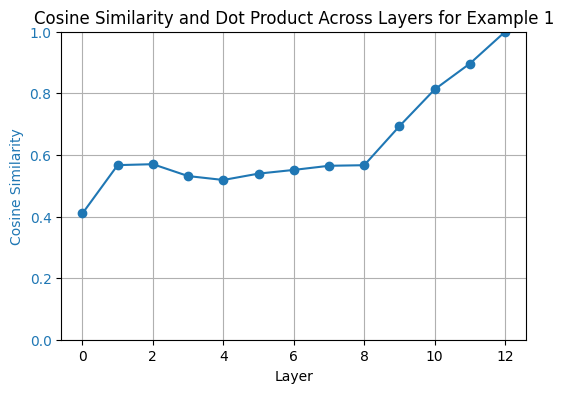

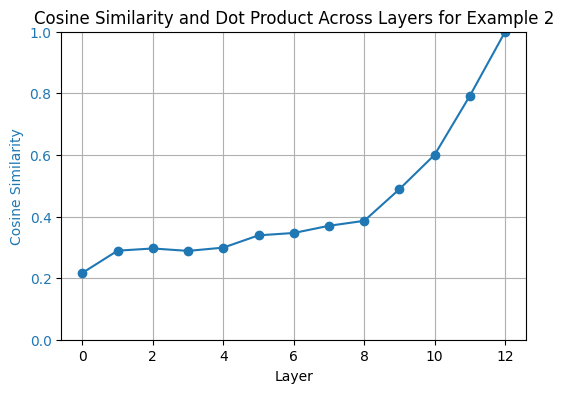

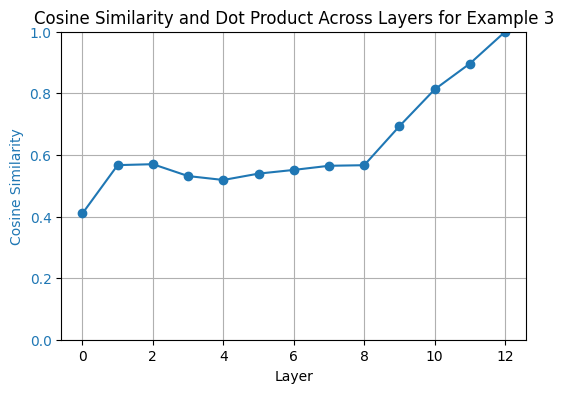

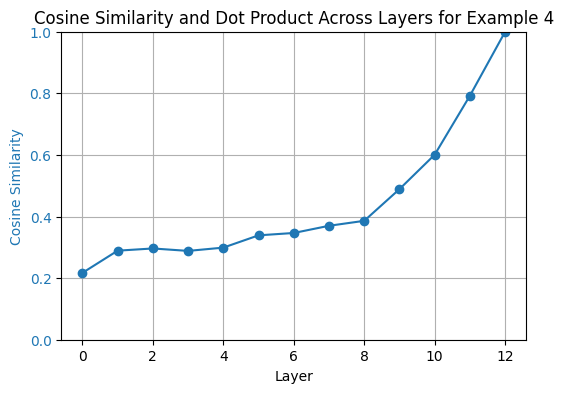

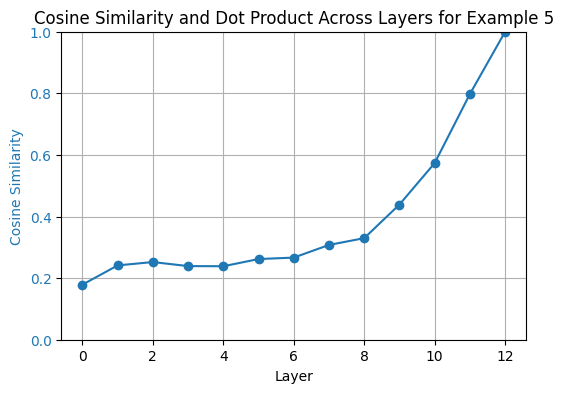

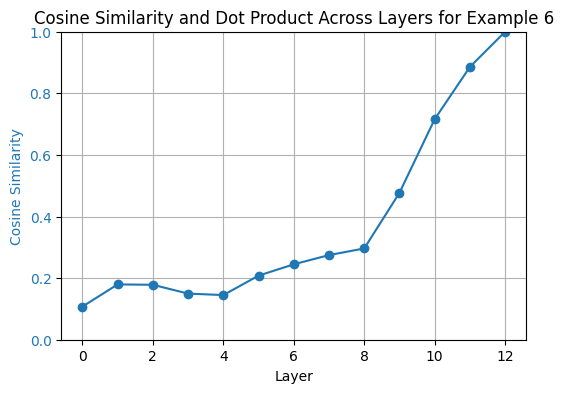

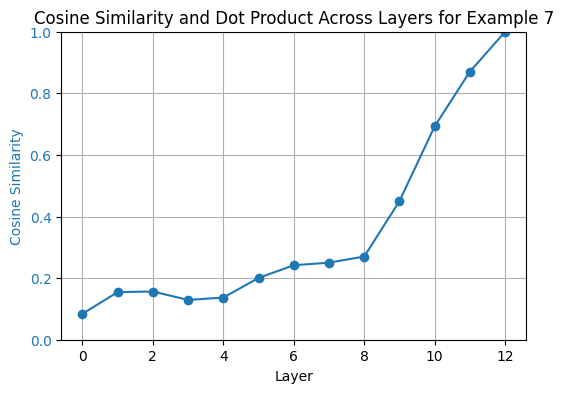

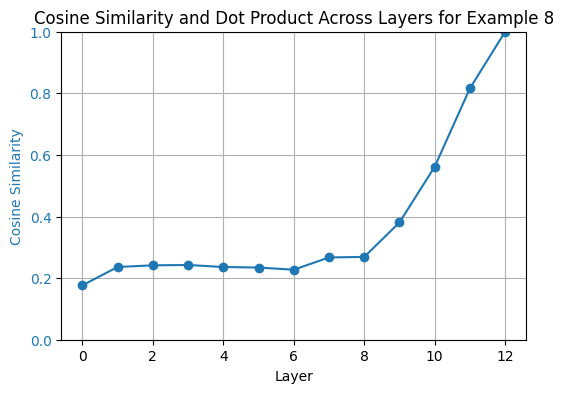

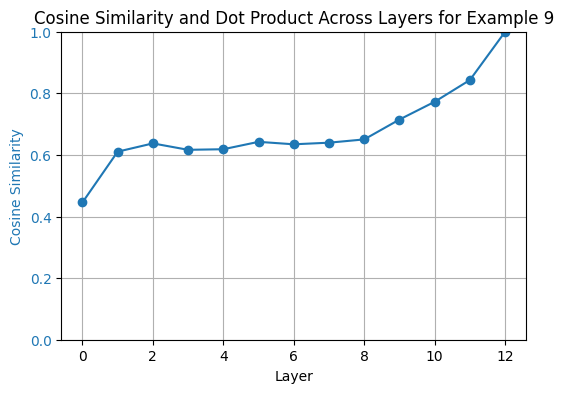

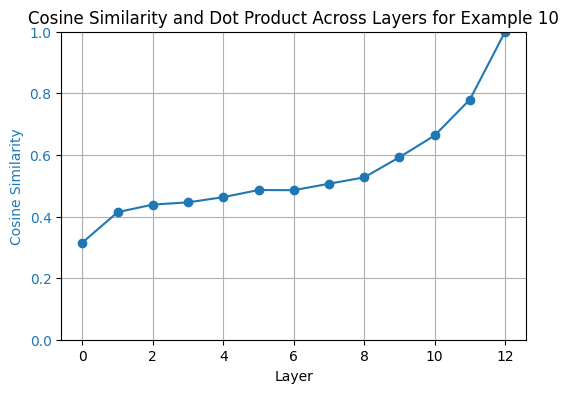

'\n1. Identifying Emotional Tone\nSub-Task: Determine the emotional tone of the review (e.g., positive, negative, neutral).\nTest Reviews:\n    EX1 "The movie\'s breathtaking scenery and exceptional soundtrack added depth to its rich storytelling." -> Positive Tone\n    EX2 "The film was a letdown with its lackluster plot and uninspired performances." -> Negative Tone\n2. Analyzing Subjective Statements\nSub-Task: Detect subjective statements or opinions in the review.\nTest Reviews:\n    EX3 "In my opinion, the film\'s portrayal of historical events was highly inaccurate." -> Subjective\n    EX4 "The movie won three Academy Awards, including Best Picture." -> Objective\n3. Evaluating Specific Aspects (Acting, Plot, Cinematography)\nSub-Task: Assess specific aspects of the movie like acting quality, plot development, and cinematography.\nTest Reviews:\n    EX5 "The acting was superb, with each character bringing depth and emotion to the screen." -> Positive Acting\n    EX6 "The plot wa

In [ ]:
input_data = simlarity

# Unpacking the tuple
cosine_sims, dot_prods = input_data

# Plotting
num_examples = cosine_sims.shape[0]
layers = list(range(0, 13))  # 12 layers excluding the final layer

cosine_similarity_ylim = (0, 1)  # Cosine similarity typically ranges from -1 to 1
dot_product_ylim = (np.min(dot_prods), np.max(dot_prods))

for i in range(num_examples):
    # Create the plot for each example
    fig, ax1 = plt.subplots(figsize=(6, 4))

    # Cosine Similarity
    color = 'tab:blue'
    ax1.set_xlabel('Layer')
    ax1.set_ylabel('Cosine Similarity', color=color)
    ax1.plot(layers, cosine_sims[i], color=color, marker='o', label='Cosine Similarity')
    ax1.tick_params(axis='y', labelcolor=color)
    ax1.set_ylim(cosine_similarity_ylim)

    # # Dot Product
    # ax2 = ax1.twinx()  # Instantiate a second axes that shares the same x-axis
    # color = 'tab:red'
    # ax2.set_ylabel('Dot Product', color=color)
    # ax2.plot(layers, dot_prods[i], color=color, marker='x', label='Dot Product')
    # ax2.tick_params(axis='y', labelcolor=color)
    # ax2.set_ylim(dot_product_ylim)

    # Title and grid
    plt.title(f'Cosine Similarity and Dot Product Across Layers for Example {i+1}')
    plt.grid(True)

    # Show the plot
    plt.show()

"""
1. Identifying Emotional Tone
Sub-Task: Determine the emotional tone of the review (e.g., positive, negative, neutral).
Test Reviews:
    EX1 "The movie's breathtaking scenery and exceptional soundtrack added depth to its rich storytelling." -> Positive Tone
    EX2 "The film was a letdown with its lackluster plot and uninspired performances." -> Negative Tone
2. Analyzing Subjective Statements
Sub-Task: Detect subjective statements or opinions in the review.
Test Reviews:
    EX3 "In my opinion, the film's portrayal of historical events was highly inaccurate." -> Subjective
    EX4 "The movie won three Academy Awards, including Best Picture." -> Objective
3. Evaluating Specific Aspects (Acting, Plot, Cinematography)
Sub-Task: Assess specific aspects of the movie like acting quality, plot development, and cinematography.
Test Reviews:
    EX5 "The acting was superb, with each character bringing depth and emotion to the screen." -> Positive Acting
    EX6 "The plot was predictable and lacked originality, making the movie quite boring." -> Negative Plot
4. Recognizing Extremes in Sentiment
Sub-Task: Identify reviews with extremely positive or negative sentiments.
Test Reviews:
    EX7 "This is possibly the worst movie ever made, with no redeeming qualities whatsoever." -> Extremely Negative
    EX8 "An absolute masterpiece, every moment was captivating and a joy to watch." -> Extremely Positive
5. Detecting Sarcasm or Irony
Sub-Task: Detect sarcasm or irony, which can often invert the apparent sentiment of a statement.
Test Reviews:
    EX9 "Oh great, another predictable rom-com, just what the world needs." -> Sarcasm
    EX10 "I loved how the movie ended abruptly without resolving any plot points." -> Irony
"""

In [ ]:
"""
1. Index 0 is embedding layer, and the following 12 layers are for transformer where number 12 is the final out.
2. Compare the cosine similarity with the CLS output of final layer.
3. A major task of reading reviews and predict it as good or bad is splitted into five sub tasks as above.
4. We can tell how much does one layer contribute to the final output from the line chart above.
5. In almost every kinds of inputs, we can see there is a leap in the first layer.
6. Along with that, in layer 2 to 8, we don't see any significant increase in all kinds of input.
7. And after layer 8, the CLS output gets closer and closer.
8. The model seems to be more sensitive to negative statement over positive statement in early layers. In EX2, it starts to increase after layer 4
9. Likewise, the model is more sensitive to objective statement over subjective statement in early layers, In EX4, it starts to increase after layer 4
10.Likewise, extremely negative over positive
11. For EX3,4 and EX9,10. The trend seems oppsite in layer 4 to 6.

Need more detailed input to find out the tasks in each layer.
Can we keep the weights of layers from 8 to 12 and trim off layer from 4 to 8?
"""

In [ ]:
#Choose cosine similarity over dot produce since it's magnitude free and the CLS embedding has already been normalized

# def cosine_similarity(vec1, vec2):
#     dot_product = np.dot(vec1, vec2)
#     norm_v1 = np.linalg.norm(vec1)
#     norm_v2 = np.linalg.norm(vec2)
#     return dot_product / (norm_v1*norm_v2)

# vector_final = cls_hidden_states[-1][1][:]
# cos_sim = []
# dot_product = []
# for vec in cls_hidden_states:
#    cos_sim.append(cosine_similarity(vector_final, vec[1][:]))
#    dot_product.append(np.dot(vector_final, vec[1][:]))

# print(cos_sim)
# print(dot_product)

[0.16682453, 0.16120712, 0.16526026, 0.2037583, 0.2514048, 0.30486768, 0.35212964, 0.37749663, 0.42058378, 0.4262469, 0.419302, 0.5245415, 1.0000001]
[61.99547, 46.028305, 51.390682, 69.527016, 101.36177, 142.53394, 175.03557, 184.07321, 202.88808, 216.66663, 209.38483, 262.26413, 390.4041]


Find out a neruon

In [ ]:
for var in bert_model.variables:
    print(f"{var.name}: {var.shape}")

tf_bert_model/bert/embeddings/word_embeddings/weight:0: (28996, 768)
tf_bert_model/bert/embeddings/token_type_embeddings/embeddings:0: (2, 768)
tf_bert_model/bert/embeddings/position_embeddings/embeddings:0: (512, 768)
tf_bert_model/bert/embeddings/LayerNorm/gamma:0: (768,)
tf_bert_model/bert/embeddings/LayerNorm/beta:0: (768,)
tf_bert_model/bert/encoder/layer_._0/attention/self/query/kernel:0: (768, 768)
tf_bert_model/bert/encoder/layer_._0/attention/self/query/bias:0: (768,)
tf_bert_model/bert/encoder/layer_._0/attention/self/key/kernel:0: (768, 768)
tf_bert_model/bert/encoder/layer_._0/attention/self/key/bias:0: (768,)
tf_bert_model/bert/encoder/layer_._0/attention/self/value/kernel:0: (768, 768)
tf_bert_model/bert/encoder/layer_._0/attention/self/value/bias:0: (768,)
tf_bert_model/bert/encoder/layer_._0/attention/output/dense/kernel:0: (768, 768)
tf_bert_model/bert/encoder/layer_._0/attention/output/dense/bias:0: (768,)
tf_bert_model/bert/encoder/layer_._0/attention/output/LayerNor

In [ ]:
def extract_ffn_second_dense_weights(bert_model):
    """
    Extracts the kernel weights from the second dense layer of the FFN in each transformer layer of the BERT model.
    """
    ffn_weights = []

    # Loop through each transformer layer and construct the variable name
    for layer_num in range(bert_model.config.num_hidden_layers):
        # Construct the variable name for the second dense layer weights in the current layer
        weight_name = f"tf_bert_model/bert/encoder/layer_._{layer_num}/output/dense/kernel:0"

        # Find and extract the variable
        for var in bert_model.variables:
            if var.name == weight_name:
                weights = var.numpy()  # Convert to numpy array
                ffn_weights.append(weights)
                break  # Move to the next layer once the weights are found

    return ffn_weights

ffn_weights = extract_ffn_second_dense_weights(bert_model)

In [ ]:
print(len(ffn_weights)) # a list with 12 inputs. 12 layers of transformer
print(ffn_weights[0].shape)
print(ffn_weights[0][0].shape) #(transformer layer, hidden layer dimensions or how many neurons in the second layer, embedding dimensions)
print(ffn_weights[0][0].shape)

12
(3072, 768)
(768,)
(768,)


In [ ]:
# input of EX1. cls_hidden_states (layer, example, embedding dimensions)
cls_token_output = cls_hidden_states[12][0][:]

def compute_cosine_similarities(cls_token_output, ffn_weights):
    # Normalize the CLS token output
    cls_norm = np.linalg.norm(cls_token_output)
    cls_token_normalized = cls_token_output / cls_norm

    cosine_similarities = []

    for layer_weights in ffn_weights:
        # Transpose the weights to align dimensions with CLS token output
        # layer_weights shape is (3072, 768), after transpose it will be (768, 3072)
        transposed_weights = layer_weights.T

        # Normalize the neuron weights
        neuron_norms = np.linalg.norm(transposed_weights, axis=0)
        normalized_neurons = transposed_weights / neuron_norms

        # Compute the dot product
        dot_product = np.dot(cls_token_normalized, normalized_neurons)

        cosine_similarities.append(dot_product)

    return cosine_similarities

#'cls_token_output' is the CLS token output of shape (768,)
# And 'ffn_weights' is a list of arrays, each of shape (3072, 768)
cosine_similarities = compute_cosine_similarities(cls_token_output, ffn_weights)

print(cosine_similarities)

[array([ 2.3209356e-02, -7.8207729e-03, -3.5420060e-05, ...,
        3.0921319e-02,  2.5828533e-02, -5.3671069e-02], dtype=float32), array([-0.04345178, -0.01417639, -0.04688938, ...,  0.13670994,
       -0.02299348,  0.02760616], dtype=float32), array([ 0.0913801 , -0.09436321,  0.06173908, ...,  0.01207003,
        0.05314217, -0.0155142 ], dtype=float32), array([0.03561677, 0.09796444, 0.1354155 , ..., 0.044703  , 0.07772051,
       0.03291572], dtype=float32), array([-0.03020649,  0.07269645,  0.11433917, ..., -0.03539241,
        0.05853854,  0.02800604], dtype=float32), array([-0.07457869,  0.00666135,  0.02701846, ..., -0.02512093,
       -0.01119658, -0.00663253], dtype=float32), array([-0.00783369, -0.00731671, -0.01789166, ..., -0.06207841,
        0.08684066,  0.0332967 ], dtype=float32), array([ 0.00627024, -0.05164554, -0.02673847, ...,  0.02024629,
        0.03688829, -0.03457628], dtype=float32), array([ 0.08470993, -0.01607816, -0.01102656, ...,  0.07671556,
        0.0

In [ ]:
print(len(cosine_similarities))
print(cosine_similarities[0].shape)

12
(3072,)


In [ ]:
# input of EX1. cls_hidden_states (layer, example, embedding dimensions)
# cls_token_output = cls_hidden_states[12][0][:]
# for loop through all inputs

import plotly.graph_objects as go

def plot_neuron_cosine_similarities_interactive(cosine_similarities):
    # Create a figure with Plotly
    fig = go.Figure()

    # Add a line for each transformer layer
    for i, layer_sim in enumerate(cosine_similarities):
        # Neuron numbers (1 to 3072)
        neuron_numbers = list(range(1, 3073))

        # Add trace
        fig.add_trace(go.Scatter(
            x=neuron_numbers,
            y=layer_sim,
            mode='lines',
            name=f'Layer {i}',
            hoverinfo='x+y'  # Show neuron number and similarity on hover
        ))

    # Update layout
    fig.update_layout(
        title='Cosine Similarities for Each Neuron in Transformer Layers',
        xaxis_title='Neuron Index',
        yaxis_title='Cosine Similarity',
        hovermode='closest'  # Update hover mode
    )

    # Show the figure
    fig.show()

# Assuming 'cosine_similarities' is your list of cosine similarities for each layer
for i in range(10):
  cls_token_output = cls_hidden_states[12][i][:]
  cosine_similarities = compute_cosine_similarities(cls_token_output, ffn_weights)
  plot_neuron_cosine_similarities_interactive(cosine_similarities)

"""
1. Identifying Emotional Tone
Sub-Task: Determine the emotional tone of the review (e.g., positive, negative, neutral).
Test Reviews:
    EX1 "The movie's breathtaking scenery and exceptional soundtrack added depth to its rich storytelling." -> Positive Tone
    EX2 "The film was a letdown with its lackluster plot and uninspired performances." -> Negative Tone
2. Analyzing Subjective Statements
Sub-Task: Detect subjective statements or opinions in the review.
Test Reviews:
    EX3 "In my opinion, the film's portrayal of historical events was highly inaccurate." -> Subjective
    EX4 "The movie won three Academy Awards, including Best Picture." -> Objective
3. Evaluating Specific Aspects (Acting, Plot, Cinematography)
Sub-Task: Assess specific aspects of the movie like acting quality, plot development, and cinematography.
Test Reviews:
    EX5 "The acting was superb, with each character bringing depth and emotion to the screen." -> Positive Acting
    EX6 "The plot was predictable and lacked originality, making the movie quite boring." -> Negative Plot
4. Recognizing Extremes in Sentiment
Sub-Task: Identify reviews with extremely positive or negative sentiments.
Test Reviews:
    EX7 "This is possibly the worst movie ever made, with no redeeming qualities whatsoever." -> Extremely Negative
    EX8 "An absolute masterpiece, every moment was captivating and a joy to watch." -> Extremely Positive
5. Detecting Sarcasm or Irony
Sub-Task: Detect sarcasm or irony, which can often invert the apparent sentiment of a statement.
Test Reviews:
    EX9 "Oh great, another predictable rom-com, just what the world needs." -> Sarcasm
    EX10 "I loved how the movie ended abruptly without resolving any plot points." -> Irony
"""

'\n1. Identifying Emotional Tone\nSub-Task: Determine the emotional tone of the review (e.g., positive, negative, neutral).\nTest Reviews:\n    EX1 "The movie\'s breathtaking scenery and exceptional soundtrack added depth to its rich storytelling." -> Positive Tone\n    EX2 "The film was a letdown with its lackluster plot and uninspired performances." -> Negative Tone\n2. Analyzing Subjective Statements\nSub-Task: Detect subjective statements or opinions in the review.\nTest Reviews:\n    EX3 "In my opinion, the film\'s portrayal of historical events was highly inaccurate." -> Subjective\n    EX4 "The movie won three Academy Awards, including Best Picture." -> Objective\n3. Evaluating Specific Aspects (Acting, Plot, Cinematography)\nSub-Task: Assess specific aspects of the movie like acting quality, plot development, and cinematography.\nTest Reviews:\n    EX5 "The acting was superb, with each character bringing depth and emotion to the screen." -> Positive Acting\n    EX6 "The plot wa

In [ ]:
cosine_similarities[0].shape

(3072,)

=================Input 0====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 307', 'Layer 0 Neuron 489', 'Layer 0 Neuron 537', 'Layer 0 Neuron 2018', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2670', 'Layer 0 Neuron 2773']
Layer 1, Neurons: ['Layer 1 Neuron 11', 'Layer 1 Neuron 113', 'Layer 1 Neuron 376', 'Layer 1 Neuron 524', 'Layer 1 Neuron 672', 'Layer 1 Neuron 1685', 'Layer 1 Neuron 1766', 'Layer 1 Neuron 1838']
Layer 2, Neurons: ['Layer 2 Neuron 57', 'Layer 2 Neuron 789', 'Layer 2 Neuron 923', 'Layer 2 Neuron 1316', 'Layer 2 Neuron 2719', 'Layer 2 Neuron 2801', 'Layer 2 Neuron 3062']
Layer 3, Neurons: ['Layer 3 Neuron 323', 'Layer 3 Neuron 693', 'Layer 3 Neuron 1469', 'Layer 3 Neuron 1795', 'Layer 3 Neuron 2233']
Layer 4, Neurons: ['Layer 4 Neuron 102', 'Layer 4 Neuron 170', 'Layer 4 Neuron 642', 'Layer 4 Neuron 915', 'Layer 4 Neuron 2116', 'Layer 4 Neuron 2548']
Layer 5, Neurons: ['Layer 5 Neuron 55']
Layer 6, Neuron

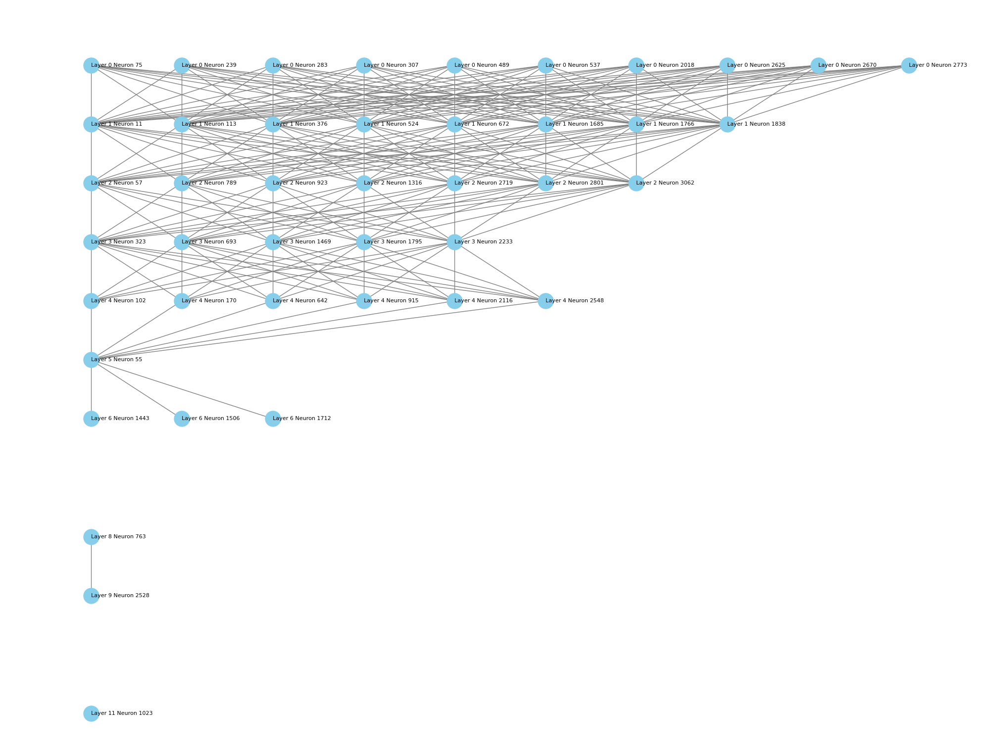

=================Input 1====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 283', 'Layer 0 Neuron 489', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2773']
Layer 1, Neurons: ['Layer 1 Neuron 1685', 'Layer 1 Neuron 1766']
Layer 2, Neurons: ['Layer 2 Neuron 789']
Layer 3, Neurons: ['Layer 3 Neuron 693']
Layer 4, Neurons: ['Layer 4 Neuron 170']
Layer 5, Neurons: []
Layer 6, Neurons: ['Layer 6 Neuron 1443']
Layer 7, Neurons: []
Layer 8, Neurons: ['Layer 8 Neuron 763']
Layer 9, Neurons: ['Layer 9 Neuron 2528']
Layer 10, Neurons: []
Layer 11, Neurons: []


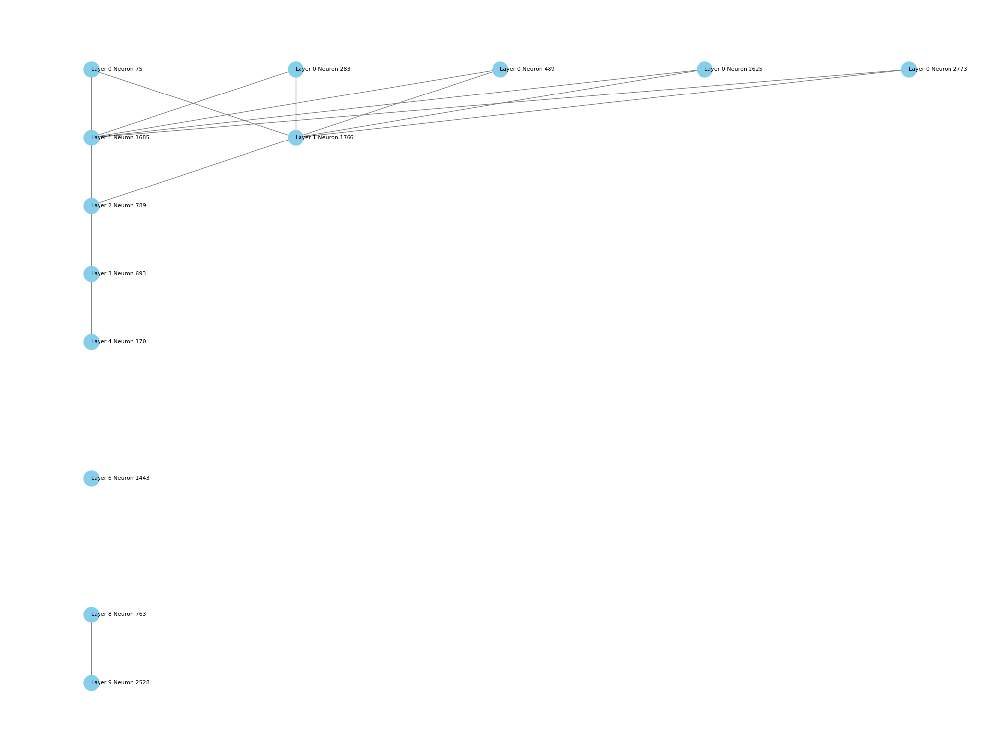

=================Input 2====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 307', 'Layer 0 Neuron 489', 'Layer 0 Neuron 537', 'Layer 0 Neuron 2018', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2670', 'Layer 0 Neuron 2773']
Layer 1, Neurons: ['Layer 1 Neuron 11', 'Layer 1 Neuron 113', 'Layer 1 Neuron 376', 'Layer 1 Neuron 524', 'Layer 1 Neuron 672', 'Layer 1 Neuron 1685', 'Layer 1 Neuron 1766', 'Layer 1 Neuron 1838']
Layer 2, Neurons: ['Layer 2 Neuron 57', 'Layer 2 Neuron 789', 'Layer 2 Neuron 923', 'Layer 2 Neuron 1316', 'Layer 2 Neuron 2719', 'Layer 2 Neuron 2801', 'Layer 2 Neuron 3062']
Layer 3, Neurons: ['Layer 3 Neuron 323', 'Layer 3 Neuron 693', 'Layer 3 Neuron 1469', 'Layer 3 Neuron 1795', 'Layer 3 Neuron 2233']
Layer 4, Neurons: ['Layer 4 Neuron 102', 'Layer 4 Neuron 170', 'Layer 4 Neuron 642', 'Layer 4 Neuron 915', 'Layer 4 Neuron 2116', 'Layer 4 Neuron 2548']
Layer 5, Neurons: ['Layer 5 Neuron 55']
Layer 6, Neuron

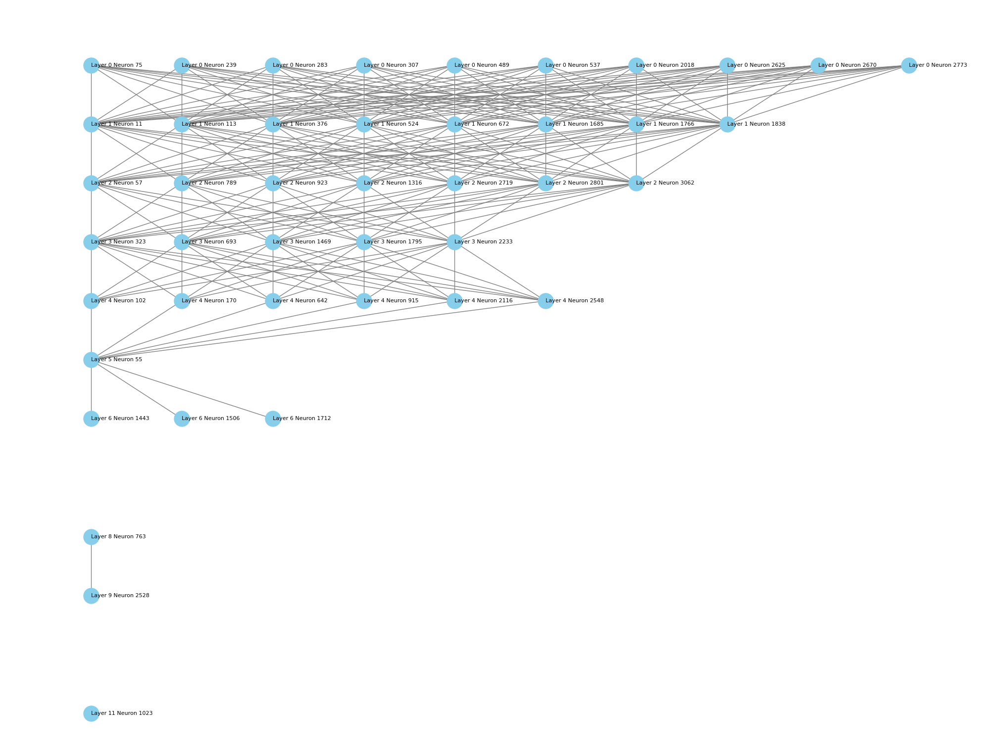

=================Input 3====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 283', 'Layer 0 Neuron 489', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2773']
Layer 1, Neurons: ['Layer 1 Neuron 1685', 'Layer 1 Neuron 1766']
Layer 2, Neurons: ['Layer 2 Neuron 789']
Layer 3, Neurons: ['Layer 3 Neuron 693']
Layer 4, Neurons: ['Layer 4 Neuron 170']
Layer 5, Neurons: []
Layer 6, Neurons: ['Layer 6 Neuron 1443']
Layer 7, Neurons: []
Layer 8, Neurons: ['Layer 8 Neuron 763']
Layer 9, Neurons: ['Layer 9 Neuron 2528']
Layer 10, Neurons: []
Layer 11, Neurons: []


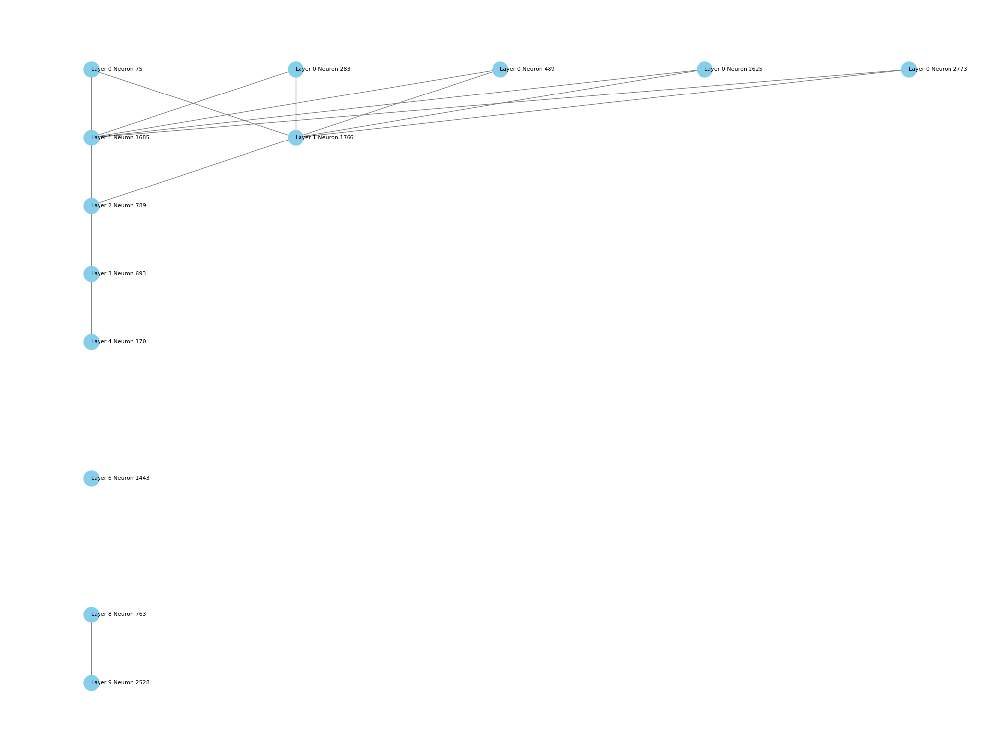

=================Input 4====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 2625']
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: []
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: []


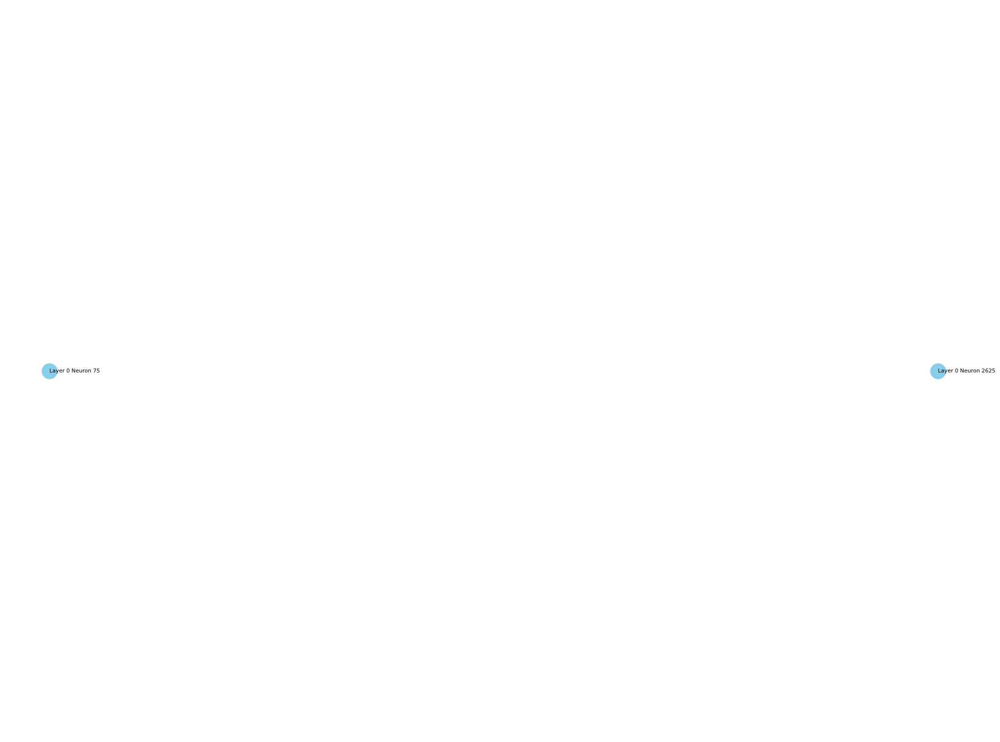

=================Input 5====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: []
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: []


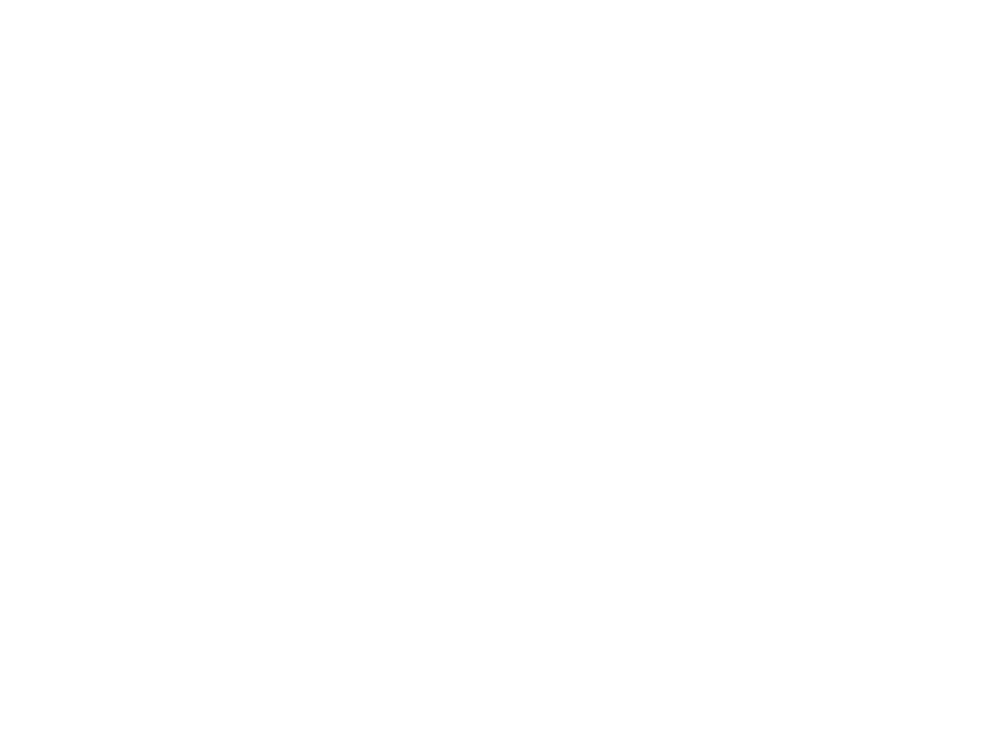

=================Input 6====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: []
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: []


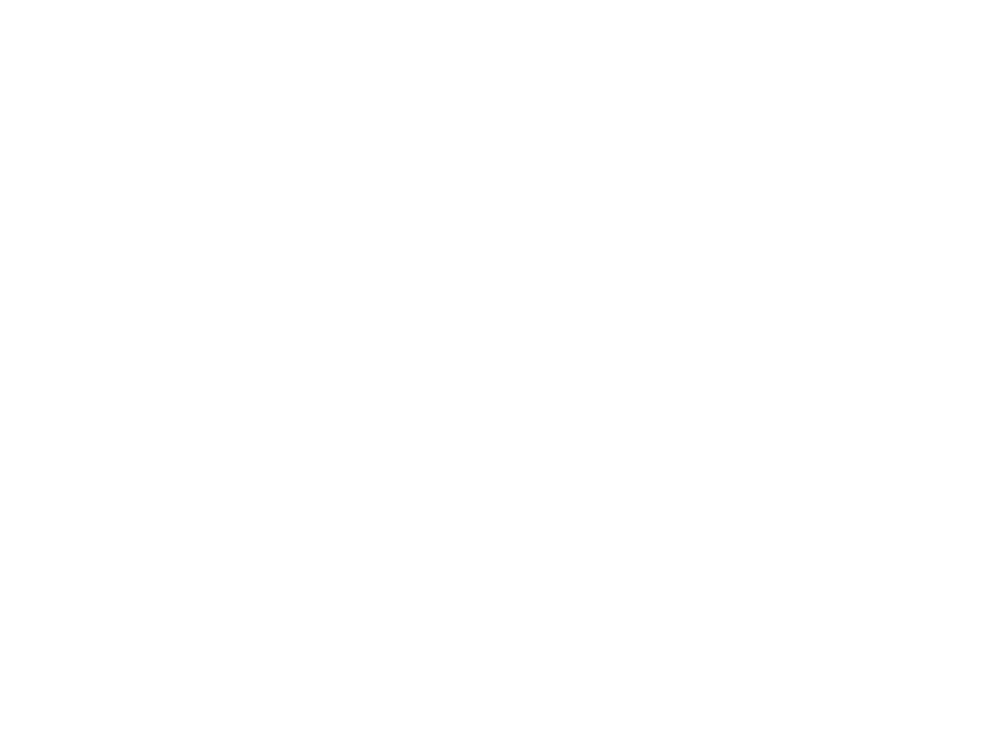

=================Input 7====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: []
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: []


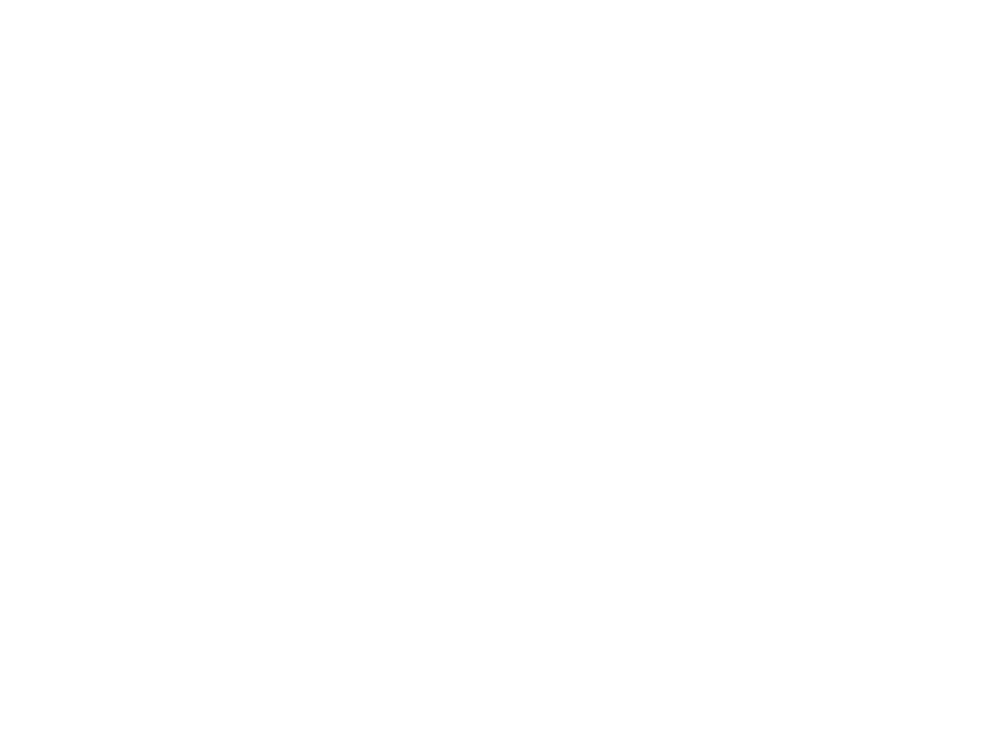

=================Input 8====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 307', 'Layer 0 Neuron 489', 'Layer 0 Neuron 537', 'Layer 0 Neuron 765', 'Layer 0 Neuron 1669', 'Layer 0 Neuron 2018', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2670', 'Layer 0 Neuron 2773']
Layer 1, Neurons: ['Layer 1 Neuron 11', 'Layer 1 Neuron 113', 'Layer 1 Neuron 376', 'Layer 1 Neuron 524', 'Layer 1 Neuron 672', 'Layer 1 Neuron 1685', 'Layer 1 Neuron 1766', 'Layer 1 Neuron 1838']
Layer 2, Neurons: ['Layer 2 Neuron 57', 'Layer 2 Neuron 789', 'Layer 2 Neuron 923', 'Layer 2 Neuron 1316', 'Layer 2 Neuron 2719', 'Layer 2 Neuron 3062']
Layer 3, Neurons: ['Layer 3 Neuron 323', 'Layer 3 Neuron 693', 'Layer 3 Neuron 1469', 'Layer 3 Neuron 1795', 'Layer 3 Neuron 2233']
Layer 4, Neurons: ['Layer 4 Neuron 102', 'Layer 4 Neuron 170', 'Layer 4 Neuron 915']
Layer 5, Neurons: ['Layer 5 Neuron 55']
Layer 6, Neurons: ['Layer 6 Neuron 1506', 'Layer 6 Neuron 171

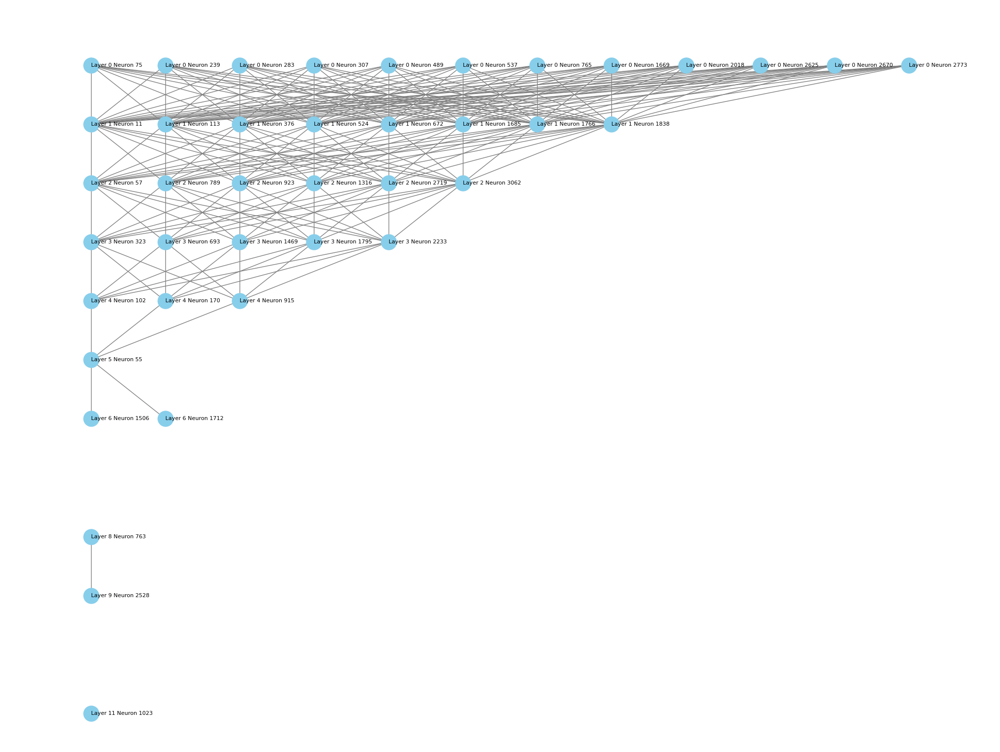

=================Input 9====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 489', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2773']
Layer 1, Neurons: ['Layer 1 Neuron 524', 'Layer 1 Neuron 1685', 'Layer 1 Neuron 1766']
Layer 2, Neurons: ['Layer 2 Neuron 789']
Layer 3, Neurons: ['Layer 3 Neuron 693']
Layer 4, Neurons: ['Layer 4 Neuron 170']
Layer 5, Neurons: []
Layer 6, Neurons: ['Layer 6 Neuron 1443']
Layer 7, Neurons: []
Layer 8, Neurons: ['Layer 8 Neuron 763']
Layer 9, Neurons: ['Layer 9 Neuron 2528']
Layer 10, Neurons: []
Layer 11, Neurons: []


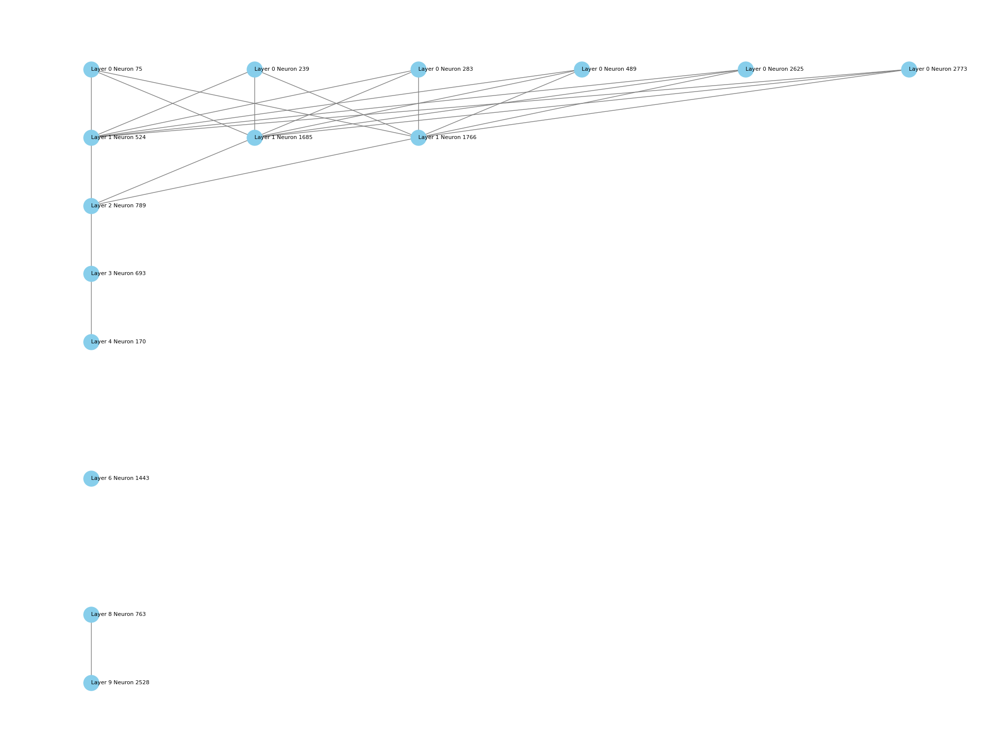

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt


def plot_graph(cls_hidden_states, ffn_weights, input_num):
    # Initialize a graph
    G = nx.Graph()
    cls_token_output = cls_hidden_states[12][input_num][:]
    cosine_similarities = compute_cosine_similarities(cls_token_output, ffn_weights)
    neuron_ids_per_layer = []

    for layer in range(12):
        neuron_ids = []

        for num, simi in enumerate(cosine_similarities[layer]):
            if simi > 0.35:
                neuron_id = f"Layer {layer} Neuron {num}"
                G.add_node(neuron_id)
                neuron_ids.append(neuron_id)

        neuron_ids_per_layer.append(neuron_ids)


        print(f"Layer {layer}, Neurons: {neuron_ids}")


    for layer in range(11):
        for current_neuron_id in neuron_ids_per_layer[layer]:
            for next_neuron_id in neuron_ids_per_layer[layer + 1]:
                G.add_edge(current_neuron_id, next_neuron_id)

    # Custom layout: nodes are aligned in vertical shelves per layer from top to bottom
    pos = {neuron_id: (i, -layer) for layer, layer_neurons in enumerate(neuron_ids_per_layer) for i, neuron_id in enumerate(layer_neurons)}

    plt.figure(figsize=(20, 15))
    nx.draw(G, pos, node_size=500, node_color='skyblue', edge_color='gray', with_labels=False)  # Turn off labels

    # Draw custom labels to avoid overlap
    for node, (x, y) in pos.items():
        plt.text(x, y, s=node, horizontalalignment='left', verticalalignment='center', fontsize=8)

    plt.show()

for i in range(10):
    print(f"=================Input {i}====================")
    plot_graph(cls_hidden_states, ffn_weights, input_num=i)

"""
1. We presume that all neurons in the current layer are connected to the next neurons in the following layer which suggests a completed information delivery from one layer to another.
   Attention wouldn't necessarily capture all information, but here we presume that it would
2. Activated neurons here have cosine similarity > 0.35 with CLS in the final layer,
3. The number of neurons for all inputs are reverse triangle beginning with many neurons activated and the number decreases across layers. There are actions like selection, decomposition, and reconstruction happening. The answer is getting clear and clear.
3. For input1 and input2 (positive or negative), there are overlapping neurons like 75,239,283.. in layer 0 but activated neurons of input2 are significantly less than neurons in input1.
4. Layers 5, 7, and 10 seem to be bottlenecks where no neurons cross the bar. In layer cosine similarity, layer 2~8 has almost no change. It seems to break the resulting output into pieces (we have 6 activated neurons in layer 5 but only 1 in layer1) and rebuild it.
5. For input1, we see a lots of bottle neck layer2 -> layer3, layer 4->5, layer 6->7 and during this process, the layer similarity wouldn't improve. When the answer fix at layer 8 neuron 763, the layer similarity increases as well. input2 also has neurons 763 on layer8
6. layer 8, 763 -> layer9 2528, layer 11 1023 seems to be golden set across the last layers. We see a lot of funnel-shaped layers formed naturally inside BERT. (Low-Rank Adaptation)
7. Need to lower the bar to 0.2 to see the low-rank adaptation actions in input3 and input4 (Subjective vs Objective)
8. odd layers are projected to low-rank dimension and even layers are project back to higher dimensions. And the overall dimension is decrease to one near the output but the cos similiarity is increasing (0.32 -> 0.39 for input 0 layer 9 and 11)
9. there is opposing information being passed down as well, funny thing is that in the layer 11 some inputs have the same set of activated neurons. ['Layer 11 Neuron 153', 'Layer 11 Neuron 1143', 'Layer 11 Neuron 2194', 'Layer 11 Neuron 2854']

pruning strategy
1. trim off 30%, 50%,  70% none actived neruons
2. trim off more in odd layers since their purpose is to create a low-rank dimension
3. trim off more in last layers of the transformer, since the information for decision-making is pretty much ready. the work left to do is to distill it and we don't need this many neruons.
4. attention?
"""



=================Input 0====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 199', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 307', 'Layer 0 Neuron 353', 'Layer 0 Neuron 489', 'Layer 0 Neuron 512', 'Layer 0 Neuron 537', 'Layer 0 Neuron 650', 'Layer 0 Neuron 702', 'Layer 0 Neuron 755', 'Layer 0 Neuron 765', 'Layer 0 Neuron 806', 'Layer 0 Neuron 1127', 'Layer 0 Neuron 1178', 'Layer 0 Neuron 1288', 'Layer 0 Neuron 1340', 'Layer 0 Neuron 1506', 'Layer 0 Neuron 1669', 'Layer 0 Neuron 1870', 'Layer 0 Neuron 2018', 'Layer 0 Neuron 2089', 'Layer 0 Neuron 2226', 'Layer 0 Neuron 2363', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2639', 'Layer 0 Neuron 2670', 'Layer 0 Neuron 2693', 'Layer 0 Neuron 2773', 'Layer 0 Neuron 2979']
Layer 1, Neurons: ['Layer 1 Neuron 3', 'Layer 1 Neuron 11', 'Layer 1 Neuron 31', 'Layer 1 Neuron 113', 'Layer 1 Neuron 142', 'Layer 1 Neuron 284', 'Layer 1 Neuron 305', 'Layer 1 Neuron 308', 'Layer 1 Neuron 357', 'Layer 1 Neuron 376', 'La

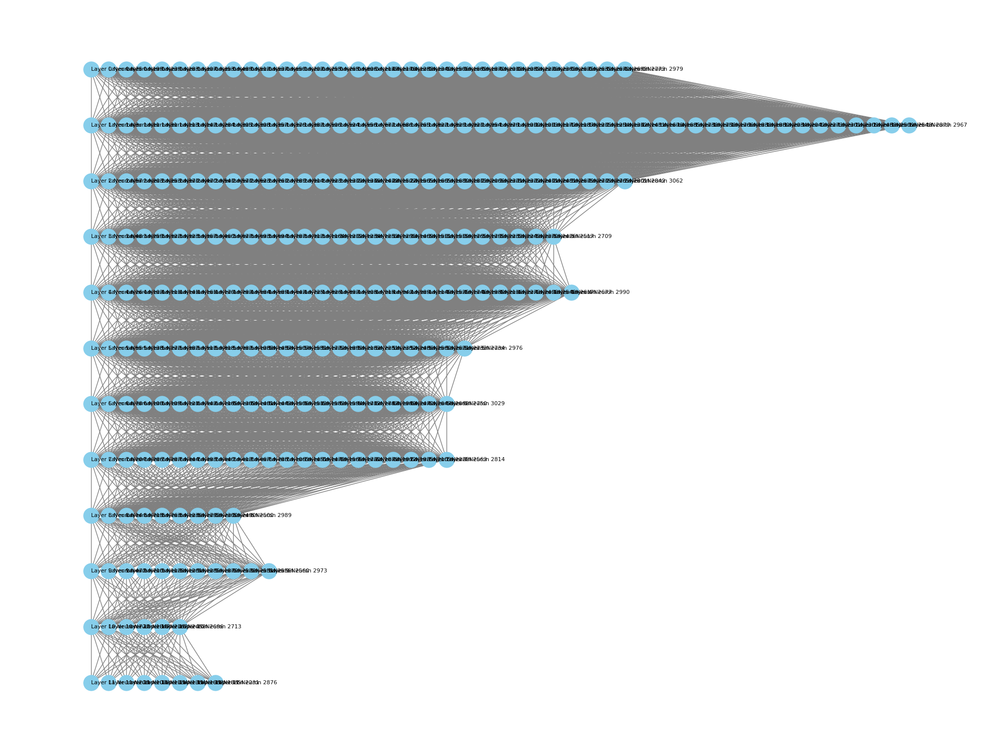

=================Input 1====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 199', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 307', 'Layer 0 Neuron 353', 'Layer 0 Neuron 489', 'Layer 0 Neuron 512', 'Layer 0 Neuron 537', 'Layer 0 Neuron 650', 'Layer 0 Neuron 755', 'Layer 0 Neuron 765', 'Layer 0 Neuron 806', 'Layer 0 Neuron 1178', 'Layer 0 Neuron 1288', 'Layer 0 Neuron 1340', 'Layer 0 Neuron 1506', 'Layer 0 Neuron 1669', 'Layer 0 Neuron 1755', 'Layer 0 Neuron 1870', 'Layer 0 Neuron 2018', 'Layer 0 Neuron 2089', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2639', 'Layer 0 Neuron 2670', 'Layer 0 Neuron 2773', 'Layer 0 Neuron 2979']
Layer 1, Neurons: ['Layer 1 Neuron 11', 'Layer 1 Neuron 31', 'Layer 1 Neuron 113', 'Layer 1 Neuron 142', 'Layer 1 Neuron 284', 'Layer 1 Neuron 376', 'Layer 1 Neuron 524', 'Layer 1 Neuron 556', 'Layer 1 Neuron 672', 'Layer 1 Neuron 686', 'Layer 1 Neuron 699', 'Layer 1 Neuron 829', 'Layer 1 Neuron 954', 'Layer 1 Neuron 1010', 'La

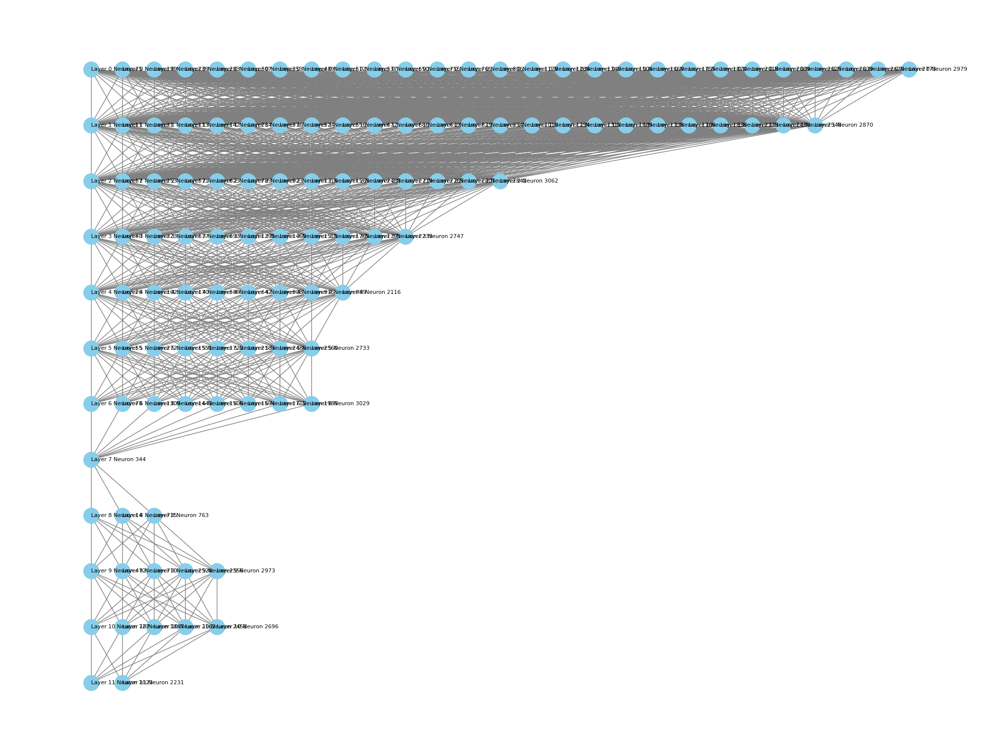

=================Input 2====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 199', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 307', 'Layer 0 Neuron 353', 'Layer 0 Neuron 489', 'Layer 0 Neuron 512', 'Layer 0 Neuron 537', 'Layer 0 Neuron 650', 'Layer 0 Neuron 702', 'Layer 0 Neuron 755', 'Layer 0 Neuron 765', 'Layer 0 Neuron 806', 'Layer 0 Neuron 1127', 'Layer 0 Neuron 1178', 'Layer 0 Neuron 1288', 'Layer 0 Neuron 1340', 'Layer 0 Neuron 1506', 'Layer 0 Neuron 1669', 'Layer 0 Neuron 1870', 'Layer 0 Neuron 2018', 'Layer 0 Neuron 2089', 'Layer 0 Neuron 2226', 'Layer 0 Neuron 2363', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2639', 'Layer 0 Neuron 2670', 'Layer 0 Neuron 2693', 'Layer 0 Neuron 2773', 'Layer 0 Neuron 2979']
Layer 1, Neurons: ['Layer 1 Neuron 3', 'Layer 1 Neuron 11', 'Layer 1 Neuron 31', 'Layer 1 Neuron 113', 'Layer 1 Neuron 142', 'Layer 1 Neuron 284', 'Layer 1 Neuron 305', 'Layer 1 Neuron 308', 'Layer 1 Neuron 357', 'Layer 1 Neuron 376', 'La

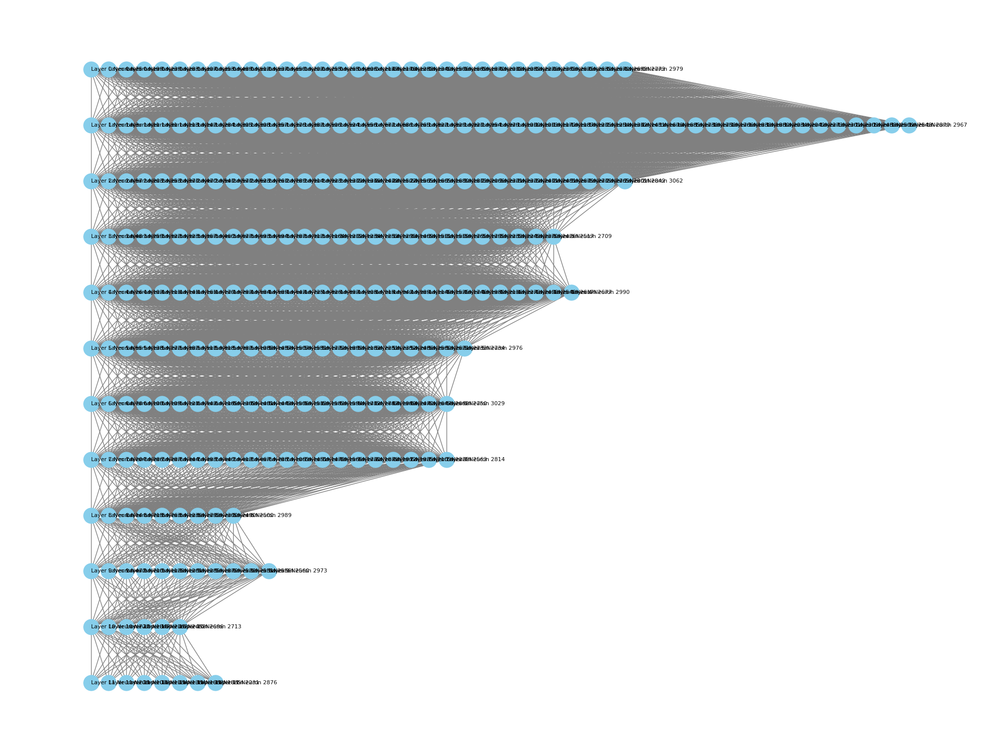

=================Input 3====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 199', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 307', 'Layer 0 Neuron 353', 'Layer 0 Neuron 489', 'Layer 0 Neuron 512', 'Layer 0 Neuron 537', 'Layer 0 Neuron 650', 'Layer 0 Neuron 755', 'Layer 0 Neuron 765', 'Layer 0 Neuron 806', 'Layer 0 Neuron 1178', 'Layer 0 Neuron 1288', 'Layer 0 Neuron 1340', 'Layer 0 Neuron 1506', 'Layer 0 Neuron 1669', 'Layer 0 Neuron 1755', 'Layer 0 Neuron 1870', 'Layer 0 Neuron 2018', 'Layer 0 Neuron 2089', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2639', 'Layer 0 Neuron 2670', 'Layer 0 Neuron 2773', 'Layer 0 Neuron 2979']
Layer 1, Neurons: ['Layer 1 Neuron 11', 'Layer 1 Neuron 31', 'Layer 1 Neuron 113', 'Layer 1 Neuron 142', 'Layer 1 Neuron 284', 'Layer 1 Neuron 376', 'Layer 1 Neuron 524', 'Layer 1 Neuron 556', 'Layer 1 Neuron 672', 'Layer 1 Neuron 686', 'Layer 1 Neuron 699', 'Layer 1 Neuron 829', 'Layer 1 Neuron 954', 'Layer 1 Neuron 1010', 'La

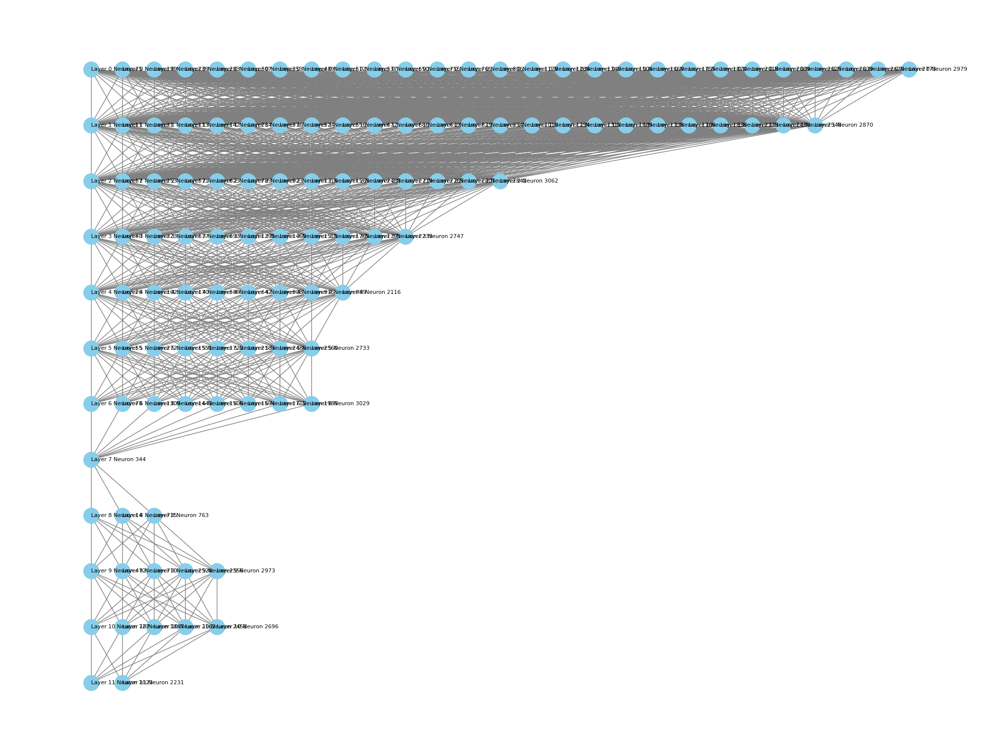

=================Input 4====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 199', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 307', 'Layer 0 Neuron 489', 'Layer 0 Neuron 537', 'Layer 0 Neuron 755', 'Layer 0 Neuron 765', 'Layer 0 Neuron 1288', 'Layer 0 Neuron 1340', 'Layer 0 Neuron 1870', 'Layer 0 Neuron 2018', 'Layer 0 Neuron 2089', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2639', 'Layer 0 Neuron 2670', 'Layer 0 Neuron 2773', 'Layer 0 Neuron 2979']
Layer 1, Neurons: ['Layer 1 Neuron 11', 'Layer 1 Neuron 31', 'Layer 1 Neuron 113', 'Layer 1 Neuron 142', 'Layer 1 Neuron 284', 'Layer 1 Neuron 376', 'Layer 1 Neuron 524', 'Layer 1 Neuron 672', 'Layer 1 Neuron 829', 'Layer 1 Neuron 1010', 'Layer 1 Neuron 1254', 'Layer 1 Neuron 1312', 'Layer 1 Neuron 1685', 'Layer 1 Neuron 1738', 'Layer 1 Neuron 1766', 'Layer 1 Neuron 1838']
Layer 2, Neurons: ['Layer 2 Neuron 57', 'Layer 2 Neuron 253', 'Layer 2 Neuron 571', 'Layer 2 Neuron 623', 'Layer 2 Neuron 789', 'Laye

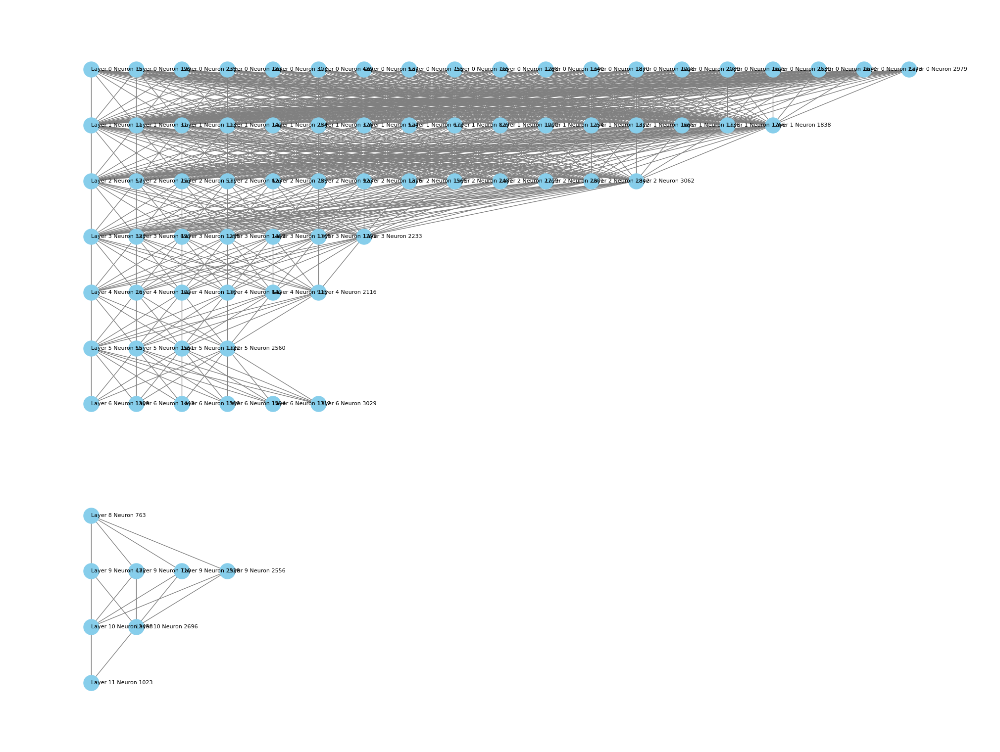

=================Input 5====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: []
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: ['Layer 10 Neuron 2458']
Layer 11, Neurons: ['Layer 11 Neuron 1688']


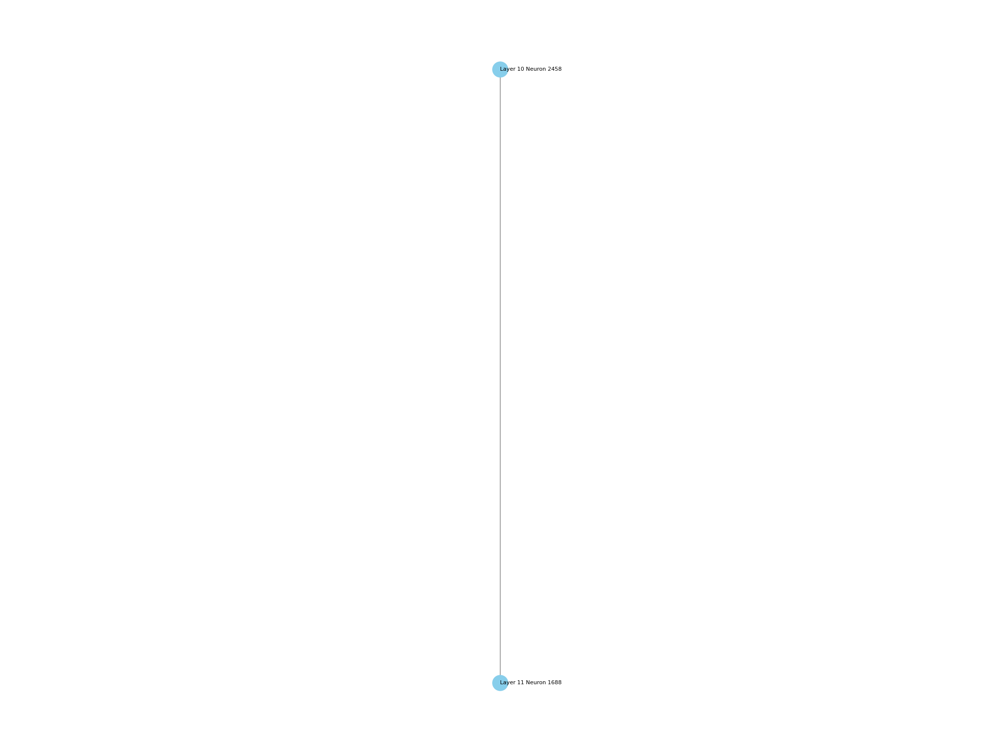

=================Input 6====================
Layer 0, Neurons: ['Layer 0 Neuron 2625']
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: []
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: ['Layer 10 Neuron 2458']
Layer 11, Neurons: ['Layer 11 Neuron 1688']


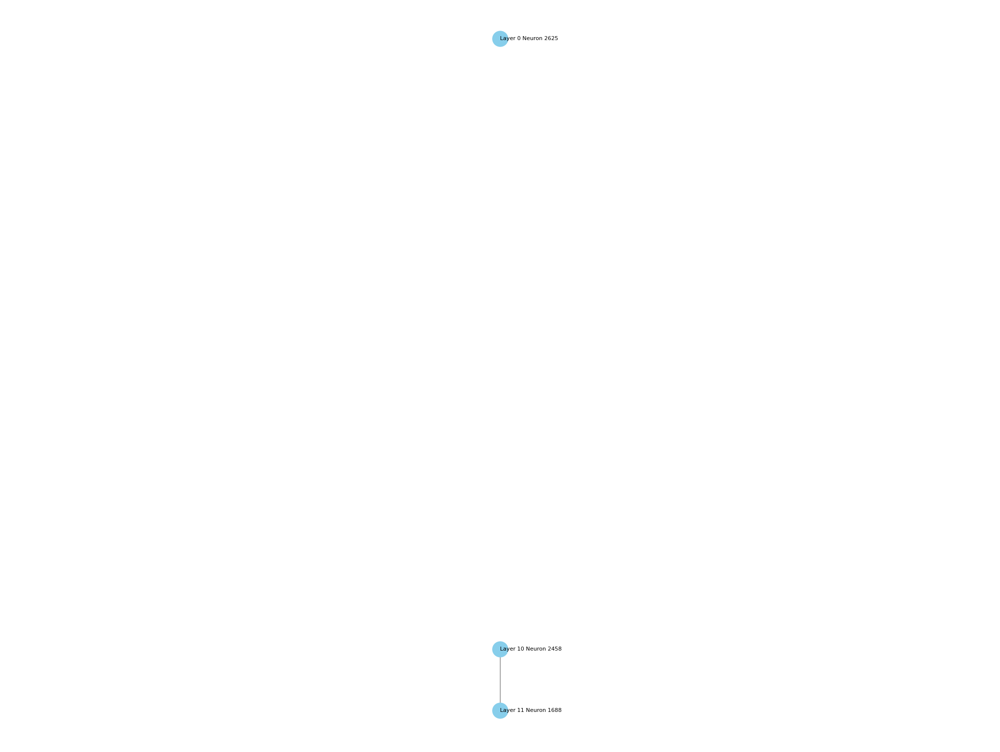

=================Input 7====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 489', 'Layer 0 Neuron 765', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2670', 'Layer 0 Neuron 2773']
Layer 1, Neurons: ['Layer 1 Neuron 113', 'Layer 1 Neuron 524', 'Layer 1 Neuron 829', 'Layer 1 Neuron 1254', 'Layer 1 Neuron 1685', 'Layer 1 Neuron 1766']
Layer 2, Neurons: ['Layer 2 Neuron 57', 'Layer 2 Neuron 789', 'Layer 2 Neuron 3062']
Layer 3, Neurons: ['Layer 3 Neuron 693']
Layer 4, Neurons: ['Layer 4 Neuron 170']
Layer 5, Neurons: []
Layer 6, Neurons: ['Layer 6 Neuron 1443']
Layer 7, Neurons: []
Layer 8, Neurons: ['Layer 8 Neuron 763']
Layer 9, Neurons: ['Layer 9 Neuron 2528']
Layer 10, Neurons: ['Layer 10 Neuron 2458']
Layer 11, Neurons: []


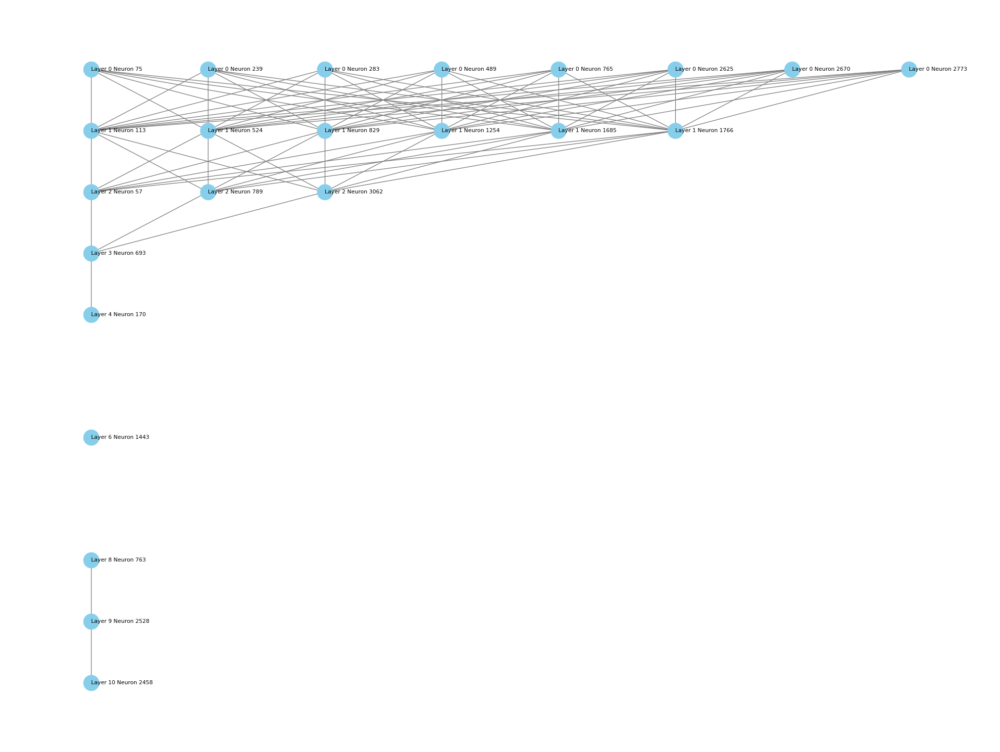

=================Input 8====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 199', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 307', 'Layer 0 Neuron 353', 'Layer 0 Neuron 489', 'Layer 0 Neuron 512', 'Layer 0 Neuron 537', 'Layer 0 Neuron 650', 'Layer 0 Neuron 702', 'Layer 0 Neuron 755', 'Layer 0 Neuron 765', 'Layer 0 Neuron 806', 'Layer 0 Neuron 1127', 'Layer 0 Neuron 1178', 'Layer 0 Neuron 1288', 'Layer 0 Neuron 1340', 'Layer 0 Neuron 1506', 'Layer 0 Neuron 1669', 'Layer 0 Neuron 1870', 'Layer 0 Neuron 2018', 'Layer 0 Neuron 2089', 'Layer 0 Neuron 2226', 'Layer 0 Neuron 2363', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2670', 'Layer 0 Neuron 2693', 'Layer 0 Neuron 2773', 'Layer 0 Neuron 2979']
Layer 1, Neurons: ['Layer 1 Neuron 11', 'Layer 1 Neuron 31', 'Layer 1 Neuron 113', 'Layer 1 Neuron 142', 'Layer 1 Neuron 284', 'Layer 1 Neuron 305', 'Layer 1 Neuron 308', 'Layer 1 Neuron 357', 'Layer 1 Neuron 376', 'Layer 1 Neuron 382', 'Layer 1 Neuron 506', 'L

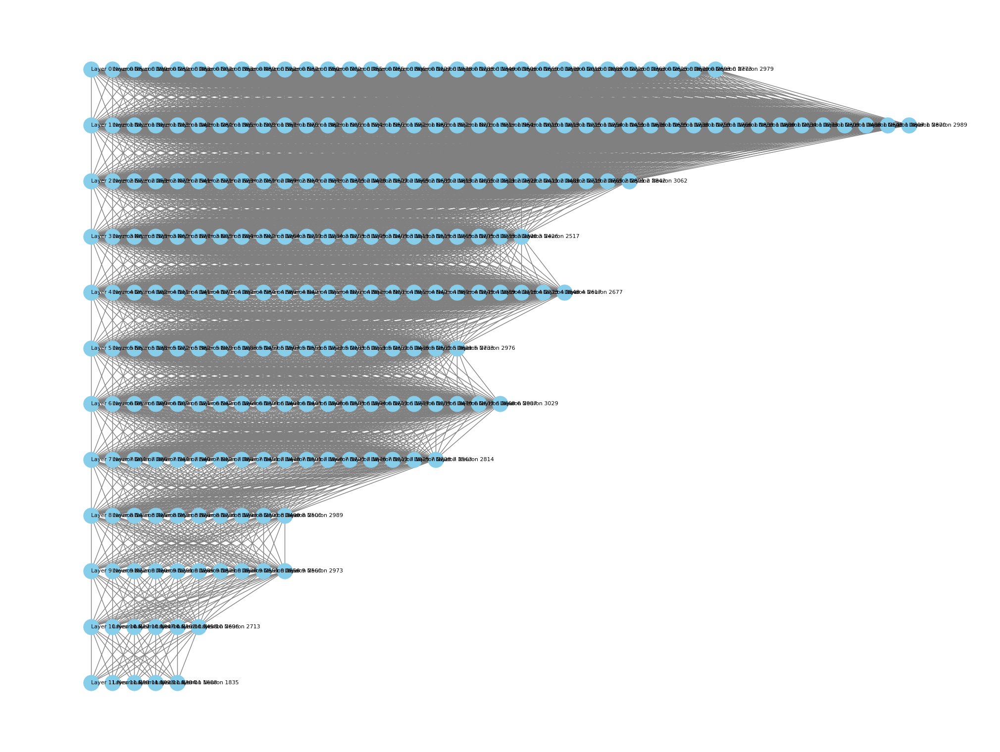

=================Input 9====================
Layer 0, Neurons: ['Layer 0 Neuron 75', 'Layer 0 Neuron 199', 'Layer 0 Neuron 239', 'Layer 0 Neuron 283', 'Layer 0 Neuron 307', 'Layer 0 Neuron 353', 'Layer 0 Neuron 489', 'Layer 0 Neuron 537', 'Layer 0 Neuron 702', 'Layer 0 Neuron 755', 'Layer 0 Neuron 765', 'Layer 0 Neuron 806', 'Layer 0 Neuron 1178', 'Layer 0 Neuron 1288', 'Layer 0 Neuron 1340', 'Layer 0 Neuron 1506', 'Layer 0 Neuron 1669', 'Layer 0 Neuron 1870', 'Layer 0 Neuron 2018', 'Layer 0 Neuron 2089', 'Layer 0 Neuron 2625', 'Layer 0 Neuron 2639', 'Layer 0 Neuron 2670', 'Layer 0 Neuron 2773', 'Layer 0 Neuron 2979']
Layer 1, Neurons: ['Layer 1 Neuron 11', 'Layer 1 Neuron 31', 'Layer 1 Neuron 113', 'Layer 1 Neuron 142', 'Layer 1 Neuron 284', 'Layer 1 Neuron 376', 'Layer 1 Neuron 524', 'Layer 1 Neuron 556', 'Layer 1 Neuron 672', 'Layer 1 Neuron 686', 'Layer 1 Neuron 829', 'Layer 1 Neuron 954', 'Layer 1 Neuron 1010', 'Layer 1 Neuron 1254', 'Layer 1 Neuron 1312', 'Layer 1 Neuron 1676', '

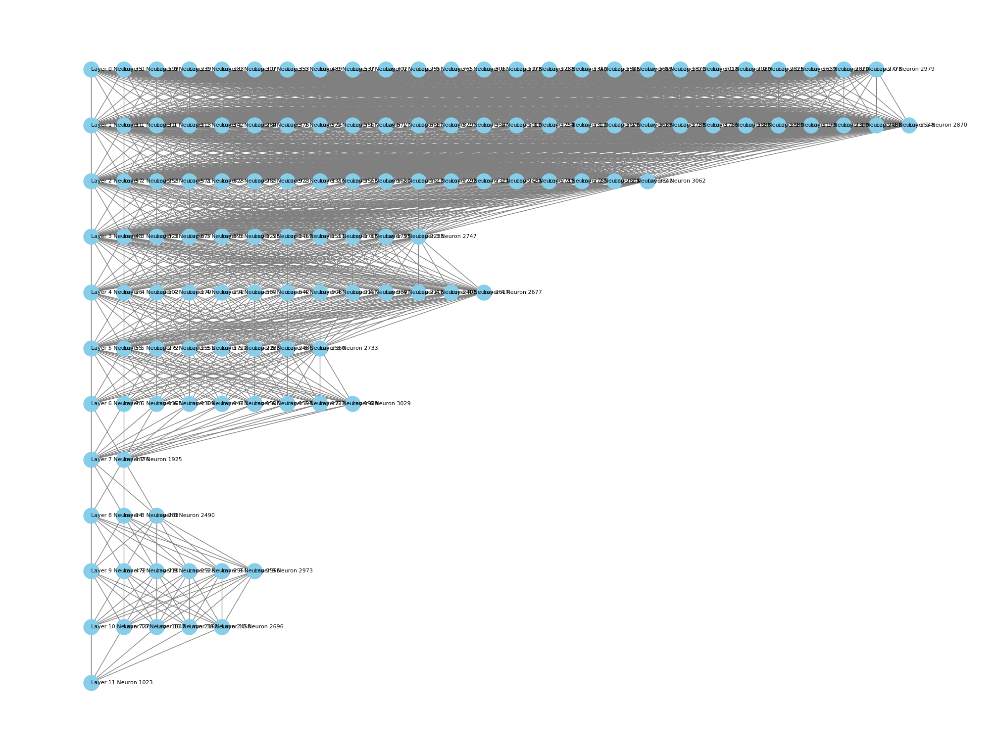

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt


def plot_graph(cls_hidden_states, ffn_weights, input_num):
    # Initialize a graph
    G = nx.Graph()
    cls_token_output = cls_hidden_states[12][input_num][:]
    cosine_similarities = compute_cosine_similarities(cls_token_output, ffn_weights)
    neuron_ids_per_layer = []

    for layer in range(12):
        neuron_ids = []

        for num, simi in enumerate(cosine_similarities[layer]):
            if simi > 0.2:
                neuron_id = f"Layer {layer} Neuron {num}"
                G.add_node(neuron_id)
                neuron_ids.append(neuron_id)

        neuron_ids_per_layer.append(neuron_ids)


        print(f"Layer {layer}, Neurons: {neuron_ids}")


    for layer in range(11):
        for current_neuron_id in neuron_ids_per_layer[layer]:
            for next_neuron_id in neuron_ids_per_layer[layer + 1]:
                G.add_edge(current_neuron_id, next_neuron_id)

    # Custom layout: nodes are aligned in vertical shelves per layer from top to bottom
    pos = {neuron_id: (i, -layer) for layer, layer_neurons in enumerate(neuron_ids_per_layer) for i, neuron_id in enumerate(layer_neurons)}

    plt.figure(figsize=(20, 15))
    nx.draw(G, pos, node_size=500, node_color='skyblue', edge_color='gray', with_labels=False)  # Turn off labels

    # Draw custom labels to avoid overlap
    for node, (x, y) in pos.items():
        plt.text(x, y, s=node, horizontalalignment='left', verticalalignment='center', fontsize=8)

    plt.show()

for i in range(10):
    print(f"=================Input {i}====================")
    plot_graph(cls_hidden_states, ffn_weights, input_num=i)



=================Input 0====================
Layer 0, Neurons: ['Layer 0 Neuron 2168']
Layer 1, Neurons: ['Layer 1 Neuron 360']
Layer 2, Neurons: ['Layer 2 Neuron 2669', 'Layer 2 Neuron 2888']
Layer 3, Neurons: []
Layer 4, Neurons: ['Layer 4 Neuron 88', 'Layer 4 Neuron 458', 'Layer 4 Neuron 1024']
Layer 5, Neurons: ['Layer 5 Neuron 2357']
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: ['Layer 11 Neuron 153', 'Layer 11 Neuron 1143', 'Layer 11 Neuron 2194', 'Layer 11 Neuron 2854']


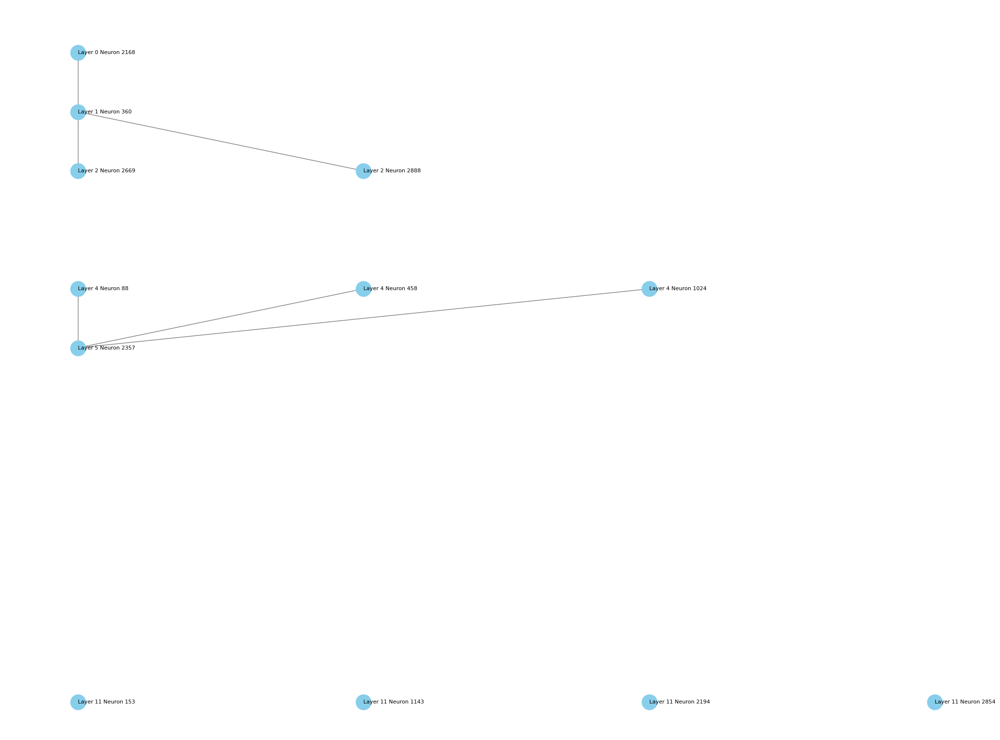

=================Input 1====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: ['Layer 4 Neuron 458']
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: []


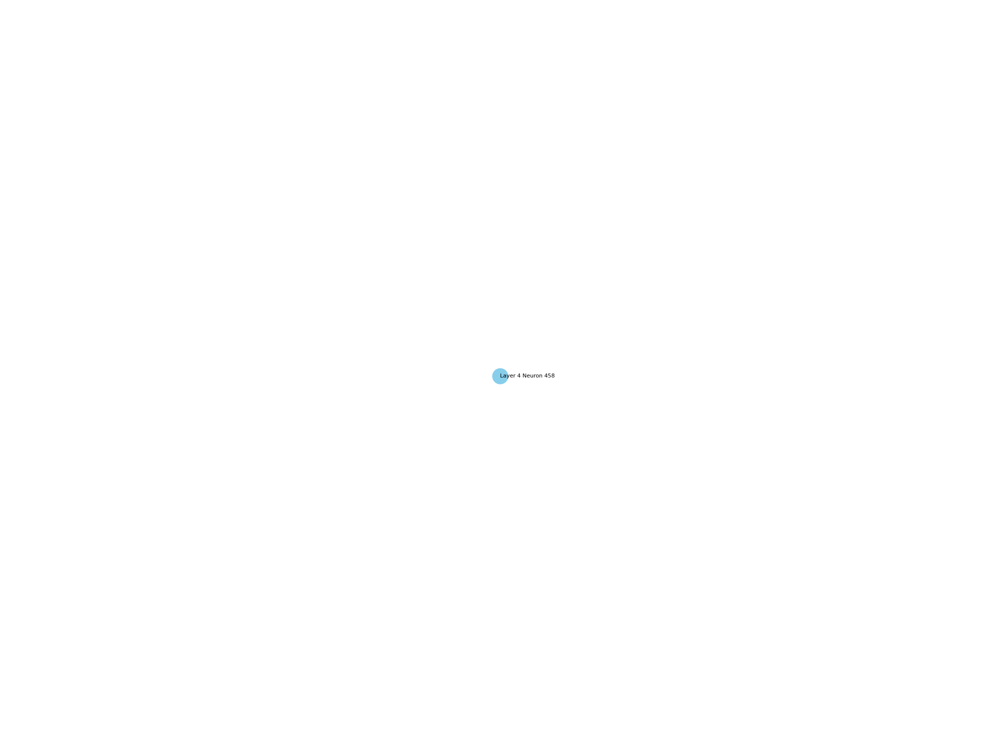

=================Input 2====================
Layer 0, Neurons: ['Layer 0 Neuron 2168']
Layer 1, Neurons: ['Layer 1 Neuron 360']
Layer 2, Neurons: ['Layer 2 Neuron 2669', 'Layer 2 Neuron 2888']
Layer 3, Neurons: []
Layer 4, Neurons: ['Layer 4 Neuron 88', 'Layer 4 Neuron 458', 'Layer 4 Neuron 1024']
Layer 5, Neurons: ['Layer 5 Neuron 2357']
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: ['Layer 11 Neuron 153', 'Layer 11 Neuron 1143', 'Layer 11 Neuron 2194', 'Layer 11 Neuron 2854']


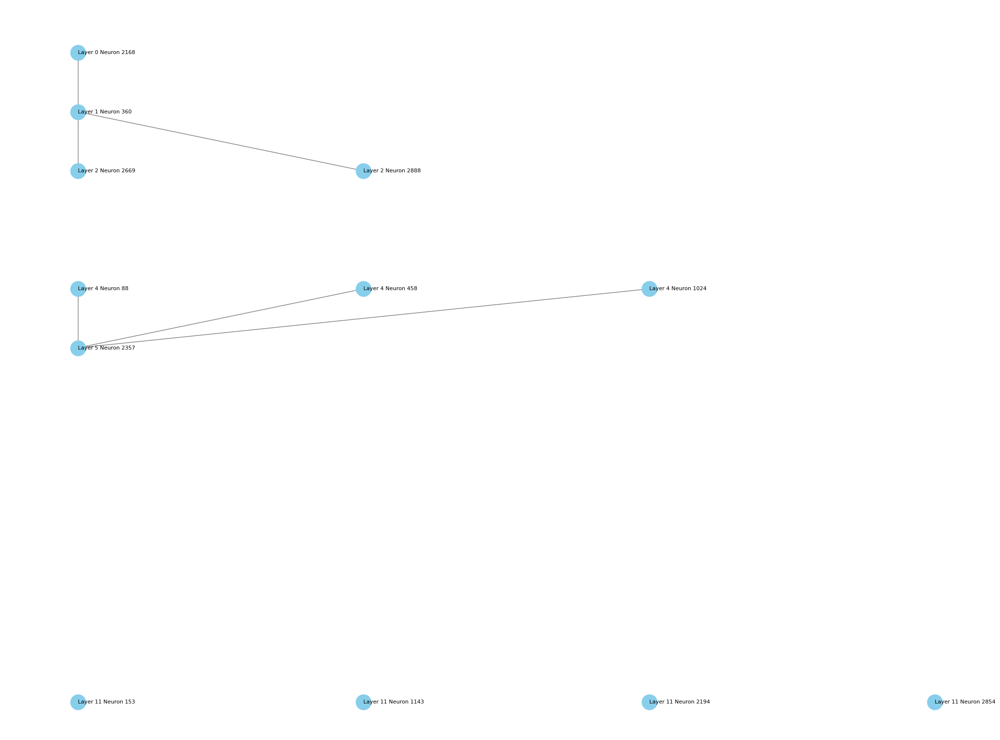

=================Input 3====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: ['Layer 4 Neuron 458']
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: []


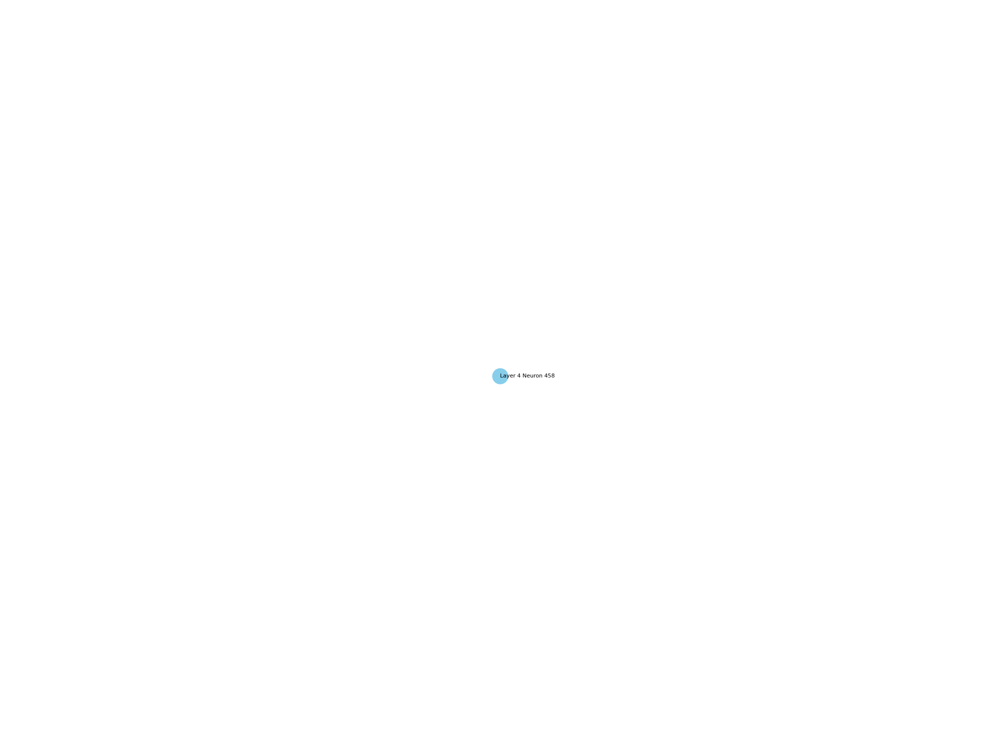

=================Input 4====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: []
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: []


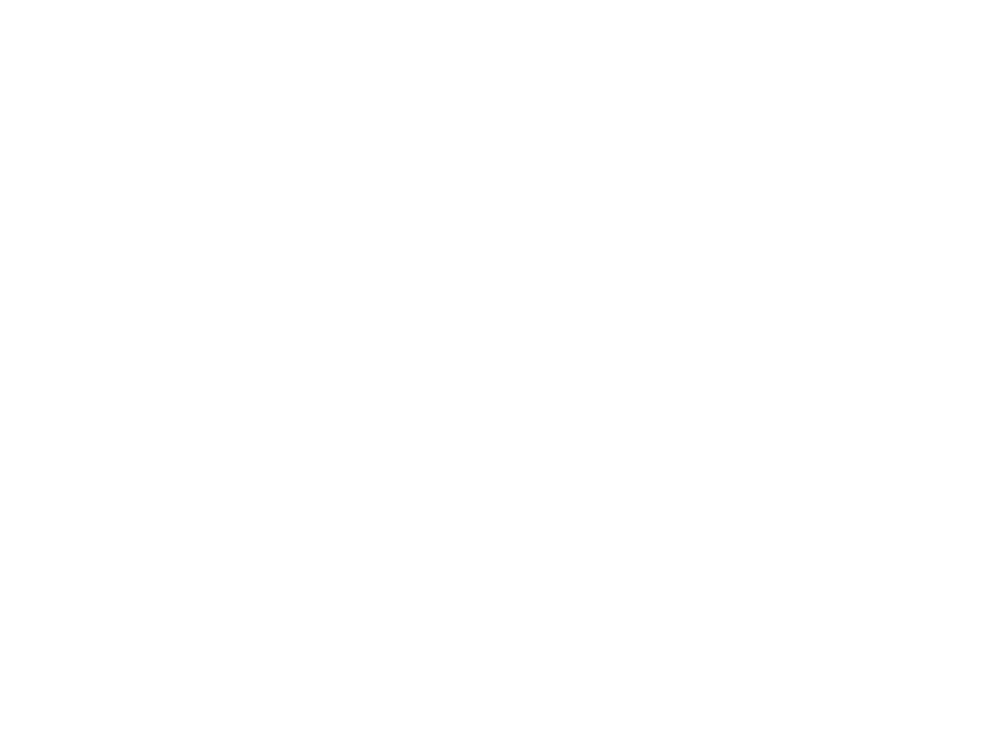

=================Input 5====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: []
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: []


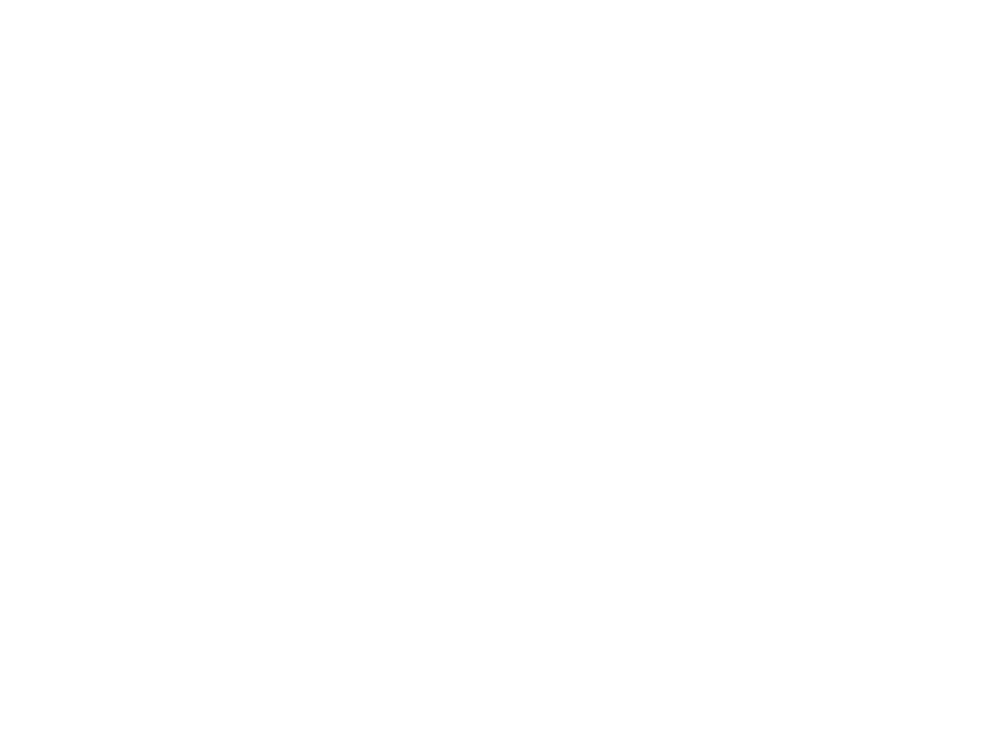

=================Input 6====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: []
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: []


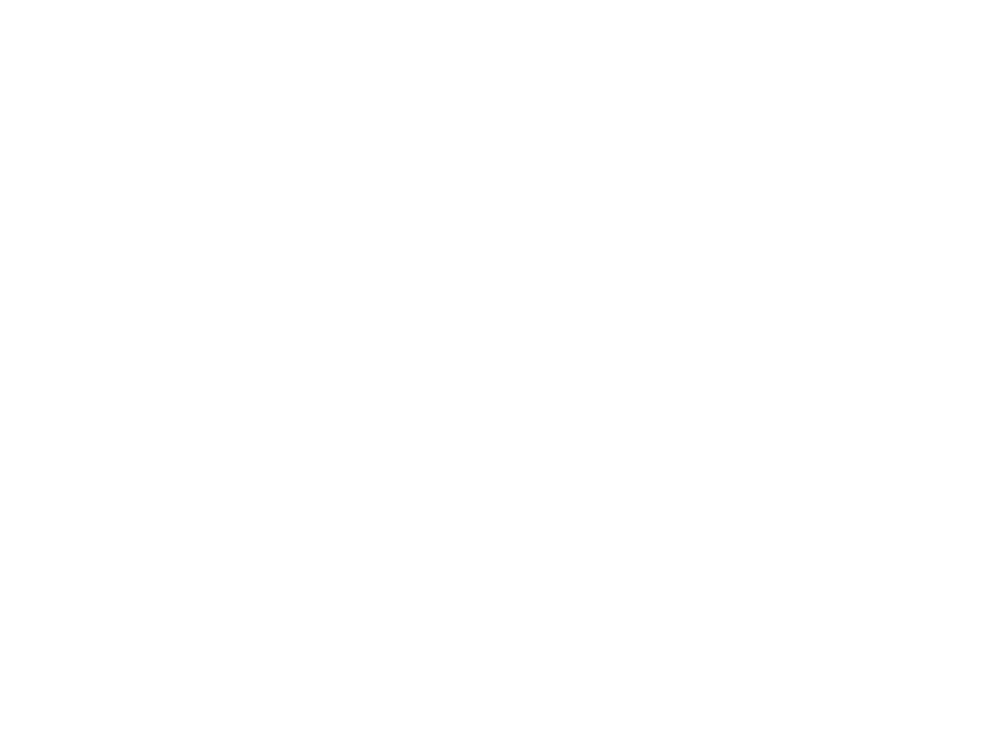

=================Input 7====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: []
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: []


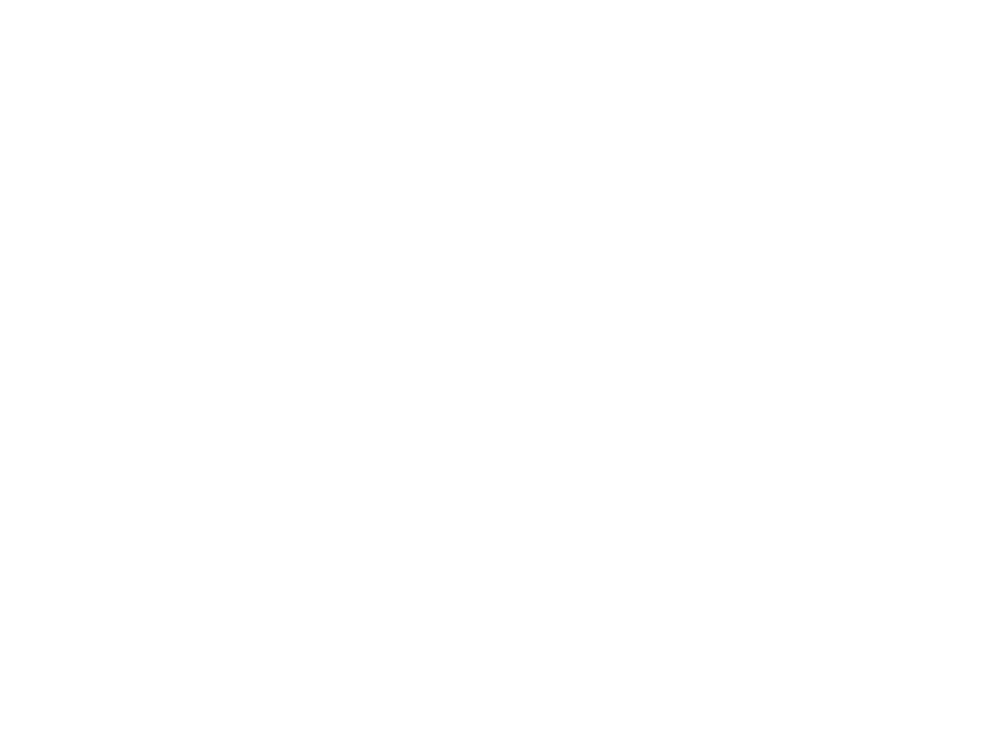

=================Input 8====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: ['Layer 2 Neuron 2669', 'Layer 2 Neuron 2888']
Layer 3, Neurons: []
Layer 4, Neurons: ['Layer 4 Neuron 88', 'Layer 4 Neuron 458']
Layer 5, Neurons: ['Layer 5 Neuron 2357']
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: ['Layer 11 Neuron 153', 'Layer 11 Neuron 1143', 'Layer 11 Neuron 2194', 'Layer 11 Neuron 2854']


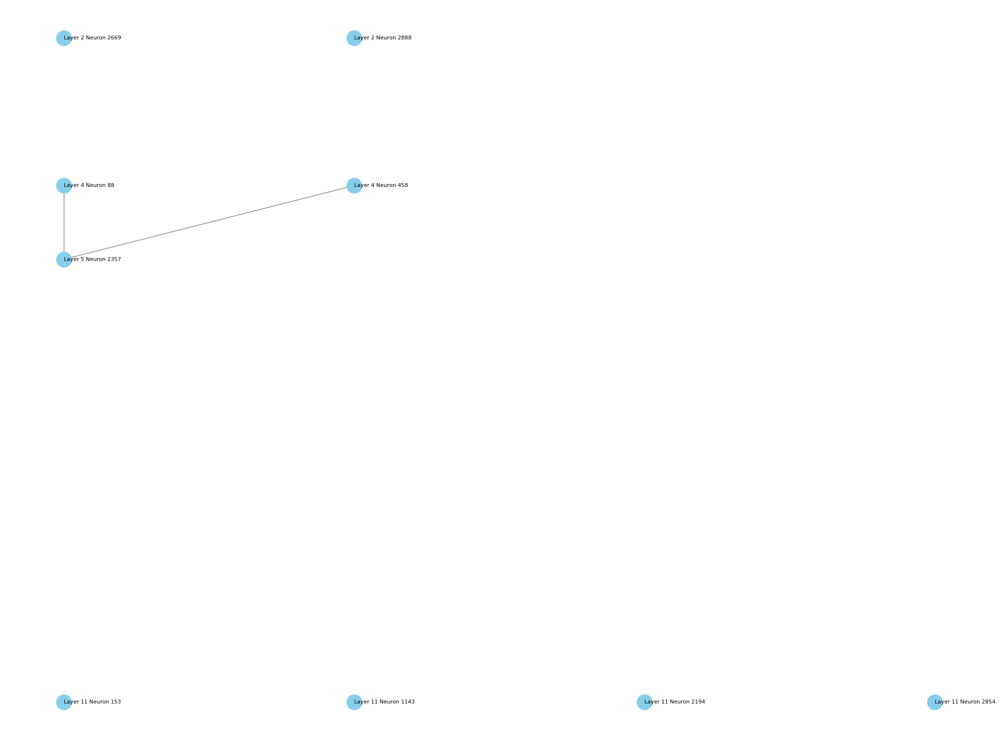

=================Input 9====================
Layer 0, Neurons: []
Layer 1, Neurons: []
Layer 2, Neurons: []
Layer 3, Neurons: []
Layer 4, Neurons: []
Layer 5, Neurons: []
Layer 6, Neurons: []
Layer 7, Neurons: []
Layer 8, Neurons: []
Layer 9, Neurons: []
Layer 10, Neurons: []
Layer 11, Neurons: ['Layer 11 Neuron 2854']


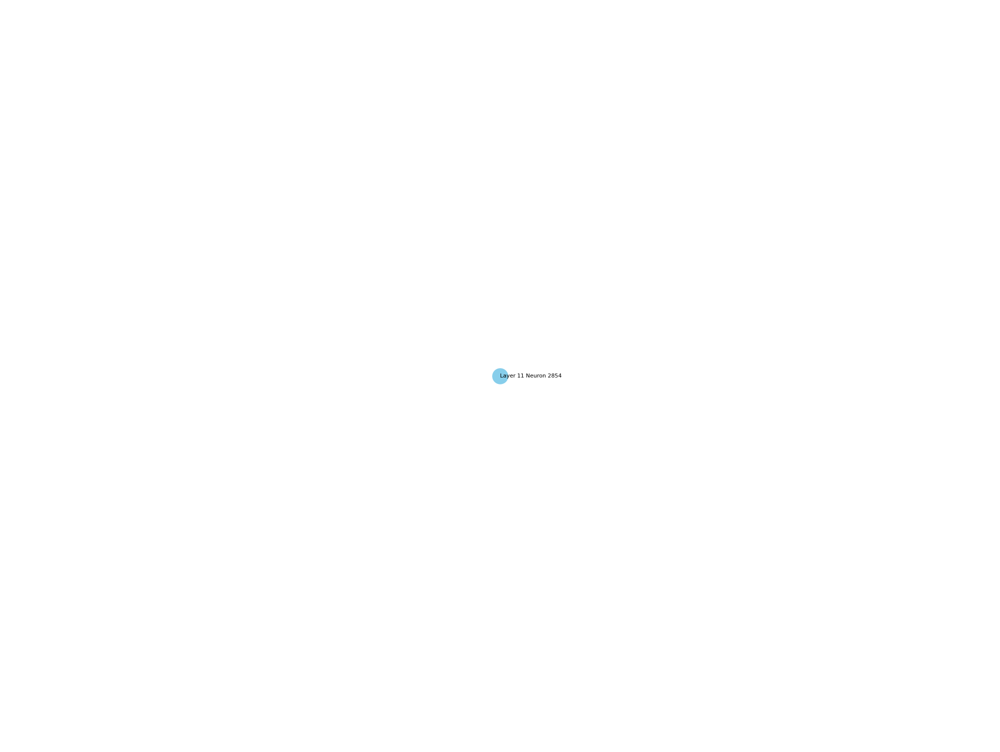

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt


def plot_graph(cls_hidden_states, ffn_weights, input_num):
    # Initialize a graph
    G = nx.Graph()
    cls_token_output = cls_hidden_states[12][input_num][:]
    cosine_similarities = compute_cosine_similarities(cls_token_output, ffn_weights)
    neuron_ids_per_layer = []

    for layer in range(12):
        neuron_ids = []

        for num, simi in enumerate(cosine_similarities[layer]):
            if simi < -0.35:
                neuron_id = f"Layer {layer} Neuron {num}"
                G.add_node(neuron_id)
                neuron_ids.append(neuron_id)

        neuron_ids_per_layer.append(neuron_ids)


        print(f"Layer {layer}, Neurons: {neuron_ids}")


    for layer in range(11):
        for current_neuron_id in neuron_ids_per_layer[layer]:
            for next_neuron_id in neuron_ids_per_layer[layer + 1]:
                G.add_edge(current_neuron_id, next_neuron_id)

    # Custom layout: nodes are aligned in vertical shelves per layer from top to bottom
    pos = {neuron_id: (i, -layer) for layer, layer_neurons in enumerate(neuron_ids_per_layer) for i, neuron_id in enumerate(layer_neurons)}

    plt.figure(figsize=(20, 15))
    nx.draw(G, pos, node_size=500, node_color='skyblue', edge_color='gray', with_labels=False)  # Turn off labels

    # Draw custom labels to avoid overlap
    for node, (x, y) in pos.items():
        plt.text(x, y, s=node, horizontalalignment='left', verticalalignment='center', fontsize=8)

    plt.show()

for i in range(10):
    print(f"=================Input {i}====================")
    plot_graph(cls_hidden_states, ffn_weights, input_num=i)

